In [2]:
import math
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib import style
import matplotlib as mpl
import paste
import scipy
import anndata
import os
import umap
from sklearn.decomposition import PCA
import scanpy as sc
import warnings
import json
from PIL import Image
import torch
import seaborn
from torch import nn
import torch.nn.functional as F
import cv2
from tqdm import tqdm
from matplotlib.colors import rgb2hex
import random

2024-08-15 17:46:18.648799: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcudart.so.11.0'; dlerror: libcudart.so.11.0: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /cm/shared/apps/slurm/current/lib64/slurm:/cm/shared/apps/slurm/current/lib64
2024-08-15 17:46:23.205786: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer.so.7'; dlerror: libnvinfer.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /cm/shared/apps/slurm/current/lib64/slurm:/cm/shared/apps/slurm/current/lib64
2024-08-15 17:46:23.206147: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer_plugin.so.7'; dlerror: libnvinfer_plugin.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /cm/shared/apps/slurm/current/lib64/slurm:/cm/shared/ap

In [3]:
def get_library_id(adata):
    assert 'spatial' in adata.uns, "spatial not present in adata.uns"
    library_ids = adata.uns['spatial'].keys()
    try:
        library_id = list(library_ids)[0]
        return library_id
    except IndexError:
        logger.error('No library_id found in adata')

def get_scalefactors(adata, library_id=None):
    if library_id is None:
        library_id = get_library_id(adata)
    try:
        scalef = adata.uns['spatial'][library_id]['scalefactors']
        return scalef
    except IndexError:
        logger.error('scalefactors not found in adata')

def get_spot_diameter_in_pixels(adata, library_id=None):
    scalef = get_scalefactors(adata, library_id=library_id) 
    try:
        spot_diameter = scalef['spot_diameter_fullres']
        return spot_diameter    
    except TypeError:
        pass
    except KeyError:
        logger.error('spot_diameter_fullres not found in adata')

In [4]:
data_path = '/condo/wanglab/shared/wxc/clip/data/human/HM_data/TNBC/'

In [5]:
sample_name = 'TNBC_processed_adata_raw'
# sample_name = 'Fang_s10'
# sample_name = 'MPBC_processed_adata'

In [6]:
fit = umap.UMAP(n_components=3)

In [7]:
pca = PCA(n_components=3)

## Coord Preprocess

In [3]:
ad_img = sc.read_h5ad('/condo/wanglab/tmhtxt85/Project/MPBC_TNBC_thor_sample/TNBC/adata_thor_result/fineST_20_initial_HE.h5ad')

In [5]:
ad_img

AnnData object with n_obs × n_vars = 122888 × 3262
    obs: 'in_tissue', 'array_row', 'array_col', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'mt_frac', 'n_counts', 'n_genes', 'spot_barcodes', 'x', 'y', 'mean_gray', 'std_gray', 'entropy_img', 'mean_r', 'mean_g', 'mean_b', 'std_r', 'std_g', 'std_b', 'spot_heterogeneity', 'node_weights'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'mt', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'used_for_prediction', 'used_for_reduced', 'used_for_vae'
    uns: 'cell_image_props', 'hvg', 'log1p', 'snn', 'spatial'
    obsm: 'spatial'
    obsp: 'snn_connectivities', 'snn_knn_connectivities', 'snn_transition_matrix'

In [6]:
ad_img.uns

{'cell_image_props': array(['x', 'y', 'mean_gray', 'std_gray', 'entropy_img', 'mean_r',
        'mean_g', 'mean_b', 'std_r', 'std_g', 'std_b'], dtype=object),
 'hvg': {'flavor': 'seurat'},
 'log1p': {},
 'snn': {'features': array(['x', 'y', 'mean_gray', 'std_gray', 'entropy_img', 'mean_r',
         'mean_g', 'mean_b', 'std_r', 'std_g', 'std_b'], dtype=object),
  'geom_constraint': 0,
  'geom_morph_ratio': 1,
  'neighbor_num': {'snn_connectivities': 5},
  'theta': 0},
 'spatial': {'TNBC_spaceranger': {'images': {'hires': array([[[0.        , 0.00784314, 0.81960785],
            [0.        , 0.00784314, 0.81960785],
            [0.        , 0.00392157, 0.8156863 ],
            ...,
            [0.        , 0.11372549, 0.9490196 ],
            [0.        , 0.11372549, 0.9490196 ],
            [0.        , 0.11372549, 0.9490196 ]],
    
           [[0.        , 0.00784314, 0.81960785],
            [0.        , 0.01176471, 0.81960785],
            [0.        , 0.00392157, 0.8156863 ],
     

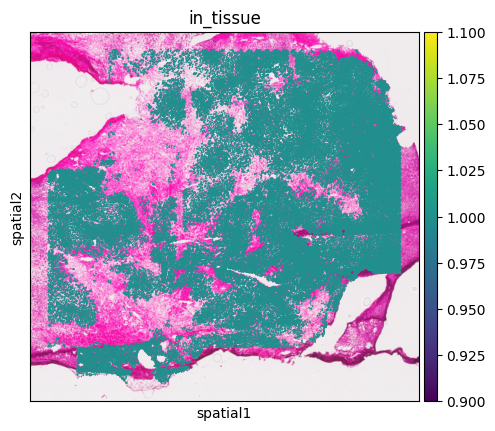

In [11]:
sc.pl.spatial(ad_img,color='in_tissue',spot_size=100)

In [8]:
wsi_coor = pd.read_csv('/condo/wanglab/tmhtxt85/Project/MPBC_TNBC_thor_sample/WSI_TNBC_ALIGN/cell_features_aligned.csv')

In [9]:
wsi_coor

,x,y
0,42491.444883,24802.457666
1,42486.663118,24830.633622
2,42508.671638,24818.469139
3,42461.545688,24789.751233
4,42485.096044,24774.459143
...,...,...
189593,32977.473556,13209.610589
189594,32958.876587,13252.921506
189595,32904.433160,13166.607433
189596,32882.469813,13220.521036


(0.0, 50000.0)

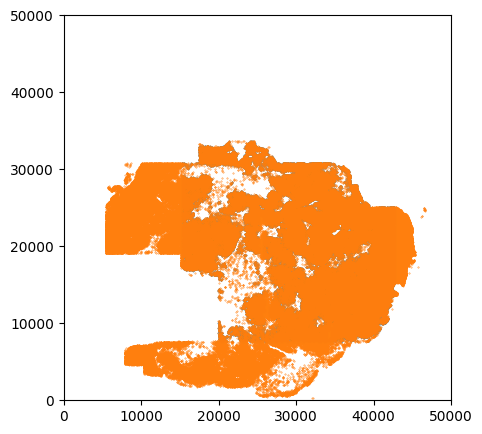

In [16]:
plt.figure(figsize=(5,5))
plt.scatter(ad_img.obsm['spatial'][:,0],ad_img.obsm['spatial'][:,1],s=0.1)
plt.scatter(wsi_coor['x'],wsi_coor['y'],s=0.1)
plt.xlim((0,50000))
plt.ylim((0,50000))

In [17]:
ad_raw = sc.read_h5ad('/condo/wanglab/tmhtxt85/Project/MPBC_TNBC_thor_sample/TNBC/processed_data/Xenium_all_cell.h5ad')

In [18]:
ad_raw

AnnData object with n_obs × n_vars = 189598 × 280
    var: 'gene_ids', 'feature_types'
    uns: 'log1p'
    obsm: 'spatial'

In [19]:
ad_raw.uns = ad_img.uns

In [21]:
ad_raw.obsm['spatial']=np.array(wsi_coor)

In [22]:
ad_raw.obs['in_tissue']=1

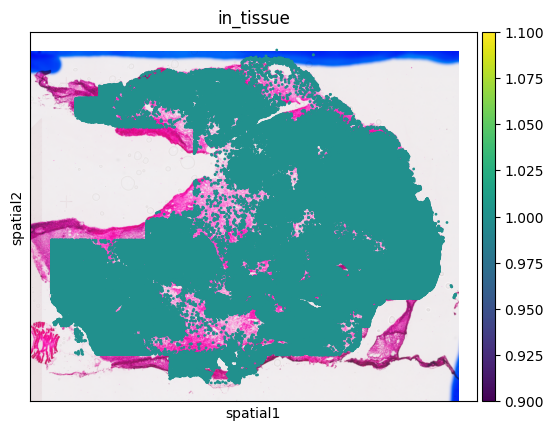

In [23]:
sc.pl.spatial(ad_raw,color='in_tissue')

In [24]:
ad_raw.write_h5ad('/condo/wanglab/shared/wxc/clip/data/human/HM_data/TNBC_Xenium.h5ad')

In [25]:
ad = sc.read_h5ad('/condo/wanglab/shared/wxc/clip/data/human/HM_data/MPBC_Xenium.h5ad')

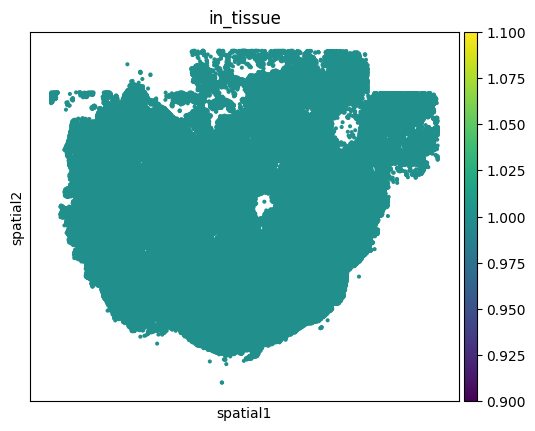

In [27]:
sc.pl.spatial(ad,color='in_tissue',alpha_img=0)

(0.0, 40000.0)

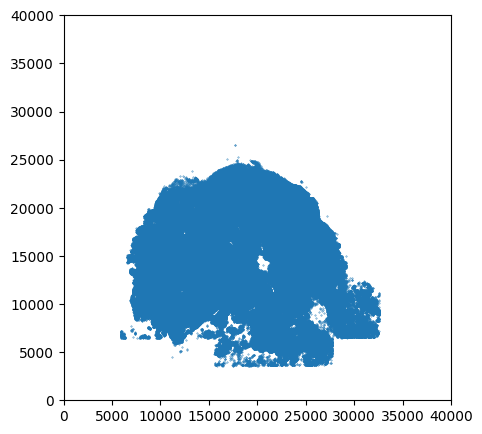

In [32]:
plt.figure(figsize=(5,5))
plt.scatter(ad.obsm['spatial'][:,0],ad.obsm['spatial'][:,1],s=0.1)
# plt.scatter(wsi_coor['x'],wsi_coor['y'],s=0.1)
plt.xlim((0,40000))
plt.ylim((0,40000))

In [1]:
import tifffile

In [3]:
img_path = '/condo/wanglab/tmhtxt85/Project/MPBC_TNBC_thor_sample/TNBC/HE.qptiff'

In [4]:
im = tifffile.imread(img_path)

In [5]:
im.shape

(84960, 61440, 3)

In [6]:
im[::100,::100].shape

(850, 615, 3)

In [7]:
import matplotlib.pyplot as plt

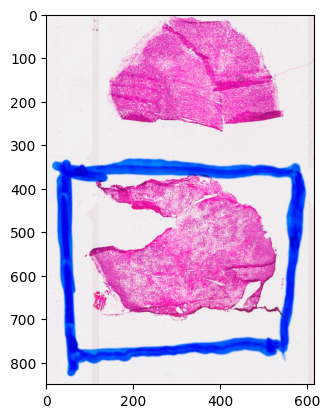

In [8]:
plt.imshow(im[::100,::100])

# Xenium Data

## Preprocess

In [308]:
# ad_xen = sc.read_h5ad('/condo/wanglab/shared/wxc/clip/data/human/HM_data/TNBC_Xenium.h5ad')
ad_xen_raw = sc.read_h5ad('/condo/wanglab/tmhtxt85/Project/MPBC_TNBC_thor_sample/TNBC/processed_data/Xenium_all_cell_count.h5ad')

In [309]:
ad_xen_raw

AnnData object with n_obs × n_vars = 189598 × 280
    var: 'gene_ids', 'feature_types'
    obsm: 'spatial'

In [310]:
ad_xen_raw.X.todense()

matrix([[0., 0., 2., ..., 0., 0., 0.],
        [0., 2., 2., ..., 0., 0., 0.],
        [0., 0., 2., ..., 0., 0., 0.],
        ...,
        [0., 1., 1., ..., 0., 0., 0.],
        [0., 1., 0., ..., 0., 0., 0.],
        [0., 0., 1., ..., 0., 0., 0.]], dtype=float32)

In [327]:
ad_xen = sc.read_h5ad('/condo/wanglab/shared/wxc/clip/data/human/HM_data/TNBC_Xenium.h5ad')

In [328]:
ad_xen_cp = ad_xen.copy()

In [329]:
del ad_xen.obs['leiden']
del ad_xen.obsm['X_pca']
del ad_xen.obsm['X_umap']
del ad_xen.varm
del ad_xen.obsp
del ad_xen.uns

In [330]:
ad_xen

AnnData object with n_obs × n_vars = 189598 × 280
    obs: 'in_tissue'
    var: 'gene_ids', 'feature_types'
    obsm: 'spatial'

In [331]:
ad_xen.uns['spatial']=ad_xen_cp.uns['spatial']

In [332]:
ad_xen

AnnData object with n_obs × n_vars = 189598 × 280
    obs: 'in_tissue'
    var: 'gene_ids', 'feature_types'
    uns: 'spatial'
    obsm: 'spatial'

In [333]:
ad_xen.X=ad_xen_raw.X

In [334]:
ad_xen

AnnData object with n_obs × n_vars = 189598 × 280
    obs: 'in_tissue'
    var: 'gene_ids', 'feature_types'
    uns: 'spatial'
    obsm: 'spatial'

In [336]:
ad_xen.write_h5ad('/condo/wanglab/shared/wxc/clip/data/human/HM_data/TNBC_Xenium_raw.h5ad')

## QC All Region

In [8]:
ad_xen = sc.read_h5ad('/condo/wanglab/shared/wxc/clip/data/human/HM_data/TNBC_Xenium_raw.h5ad')

In [9]:
ad_xen

AnnData object with n_obs × n_vars = 189598 × 280
    obs: 'in_tissue'
    var: 'gene_ids', 'feature_types'
    uns: 'spatial'
    obsm: 'spatial'

In [10]:
ad_xen.X.todense()

matrix([[0., 0., 2., ..., 0., 0., 0.],
        [0., 2., 2., ..., 0., 0., 0.],
        [0., 0., 2., ..., 0., 0., 0.],
        ...,
        [0., 1., 1., ..., 0., 0., 0.],
        [0., 1., 0., ..., 0., 0., 0.],
        [0., 0., 1., ..., 0., 0., 0.]], dtype=float32)

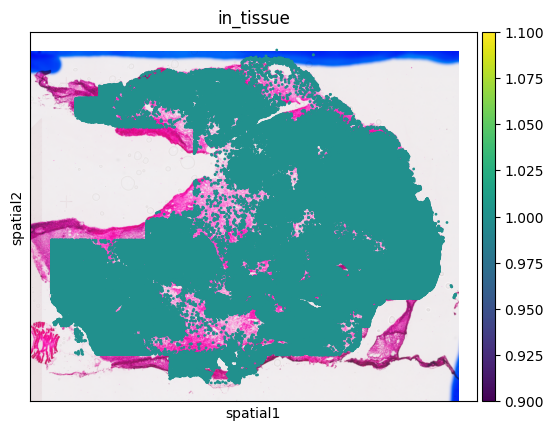

In [92]:
sc.pl.spatial(ad_xen, color='in_tissue')

In [100]:
ad_xen.layers["counts"] = ad_xen.X.copy()

In [101]:
sc.pp.filter_cells(ad_xen, min_counts=10)

In [102]:
ad_xen

AnnData object with n_obs × n_vars = 186606 × 280
    obs: 'in_tissue', 'n_counts'
    var: 'gene_ids', 'feature_types'
    uns: 'spatial'
    obsm: 'spatial'
    layers: 'counts'

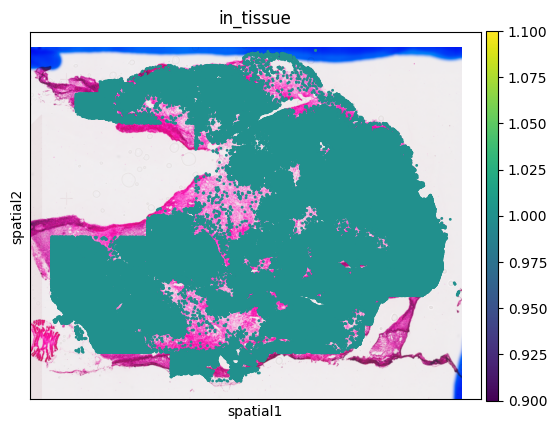

In [103]:
sc.pl.spatial(ad_xen, color='in_tissue')

In [105]:
sc.pp.normalize_total(ad_xen)
sc.pp.log1p(ad_xen)

In [106]:
sc.pp.pca(ad_xen)

In [127]:
sc.pp.neighbors(ad_xen)
# sc.pp.neighbors(ad_xen_sp, n_neighbors=20)

In [128]:
# sc.tl.leiden(ad_xen_sp, resolution=1.3)
sc.tl.leiden(ad_xen)

In [129]:
# sc.tl.umap(ad_xen_sp)
sc.tl.umap(ad_xen, min_dist=0.1)

/condo/wanglab/hmaiwxc/anaconda3/envs/clip/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


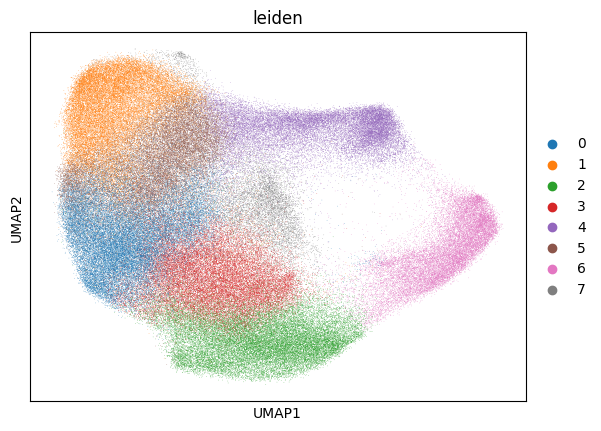

In [130]:
sc.pl.umap(ad_xen, color='leiden', color_map='tab10')

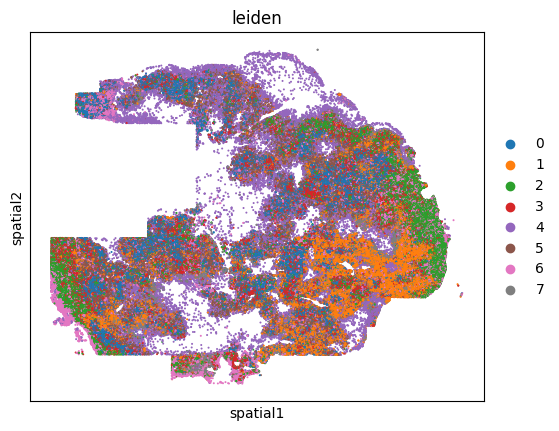

In [131]:
sc.pl.spatial(ad_xen, color='leiden', alpha_img=0, spot_size=200)

In [132]:
sc.tl.tsne(ad_xen)

/condo/wanglab/hmaiwxc/anaconda3/envs/clip/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


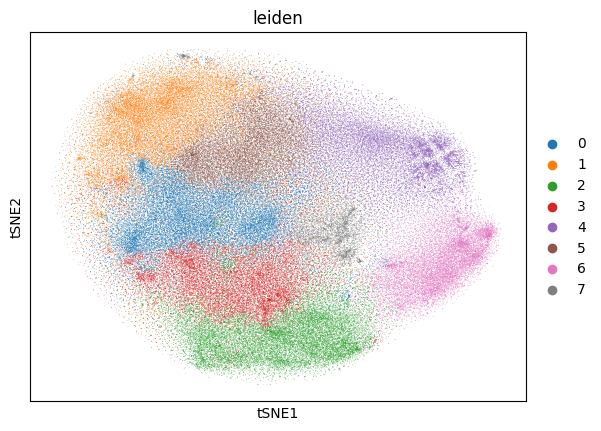

In [133]:
sc.pl.tsne(ad_xen, color='leiden')

In [134]:
# sc.tl.louvain(ad_xen_sp, resolution=1.4)
sc.tl.louvain(ad_xen)

/condo/wanglab/hmaiwxc/anaconda3/envs/clip/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


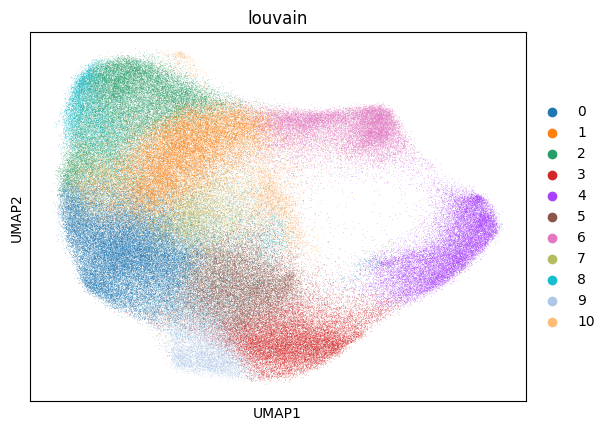

In [135]:
sc.pl.umap(ad_xen, color='louvain')

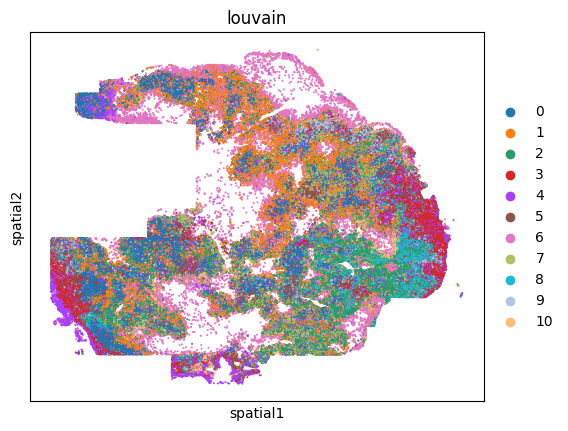

In [136]:
sc.pl.spatial(ad_xen, color='louvain', alpha_img=0, spot_size=200)

In [12]:
ad_xen = sc.read_h5ad('/condo/wanglab/shared/wxc/clip/data/human/HM_data/TNBC_Xenium_anno.h5ad')

In [13]:
marker_genes = {
    "Epithelial": ["KRT7", "KRT8", "KRT14", "KRT23", "ERBB2", "CDH1", "EPCAM", "EGFR", "KLF5", "DSP", "FOXA1"],
    "Myoepithelial": ["ACTA2"],
    "Macrophage": ["LYZ", "CD68", "FCER1G", "ITGAX", "CD163", "MRC1", "ITGAM", "FGL2", "ZEB2"],
    "Stroma": ["POSTN", "PDGFRB", "FBLN1", "TCF4", "LRRC15"],
    "B Cell": ["MZB1", "CD79A", "CD19", "CD79B", "MS4A1", "BANK1"],
    "Endothelial": ["VWF", "KDR", "CAV1", "ESM1", "PECAM1", "EGFL7"],
    "T Cell": ["PTPRC", "IL2RA", "CD3E", "FOXP3", "SLAMF7", "SLAMF1", "RORC", "CD4", "CD8A", "CTLA4", "IL7R", "CCL5", "IL2RG"],
    "Mast Cell": ["CD69"],
    "DCIS": ["CEACAM6"],
    "Invasive Tumor":["FASN"],
}

/condo/wanglab/hmaiwxc/anaconda3/envs/clip/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


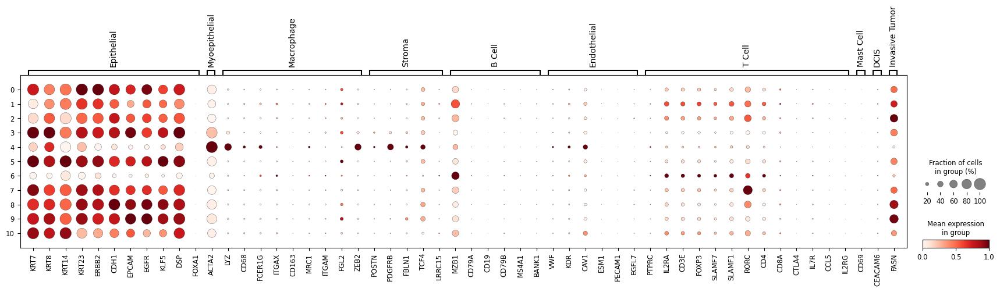

In [14]:
sc.pl.dotplot(ad_xen, marker_genes, 
              # groupby="leiden", 
              groupby="louvain", 
              standard_scale="var"
             )

In [15]:
ad_xen.obs['cell_type'] = ad_xen.obs['cell_type'].cat.reorder_categories(['Epithelial', 'Stroma', 'Immune'])

In [16]:
ad_xen.obs['cell_type']

aaaadjeh-1    Epithelial
aaaafmll-1    Epithelial
aaaahcpb-1    Epithelial
aaaaibfe-1    Epithelial
aaaajcfe-1    Epithelial
                 ...    
oilfamde-1    Epithelial
oilfccnd-1    Epithelial
oilfhkkg-1    Epithelial
oilgaoff-1    Epithelial
oilgbcik-1    Epithelial
Name: cell_type, Length: 186606, dtype: category
Categories (3, object): ['Epithelial', 'Stroma', 'Immune']

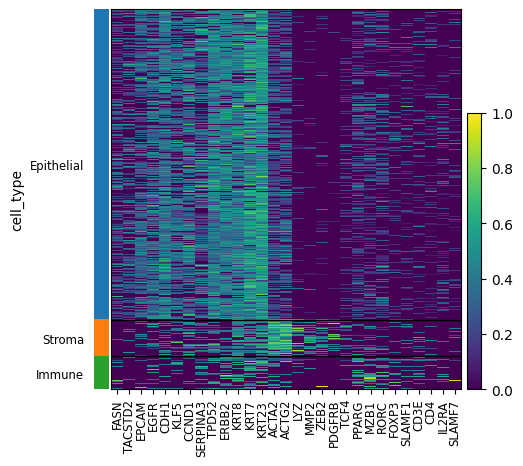

In [17]:
markers = ['FASN', 'TACSTD2', 'EPCAM', 'EGFR', 'CDH1', 'KLF5',  'CCND1', 'SERPINA3', 'TPD52', 'ERBB2', 
           #'TOP2A',
                      'KRT8', 'KRT7', 'KRT23', 
            'ACTA2', 'ACTG2', 'LYZ', 'MMP2', 'ZEB2', 'PDGFRB', 'TCF4', 
           'PPARG', 'MZB1', 'RORC', 'FOXP3', 'SLAMF1', 'CD3E', 'CD4', 'IL2RA', 'SLAMF7',
]
sc.pl.heatmap(ad_xen, markers, groupby='cell_type', 
              standard_scale='var',
              figsize=(5,5)
             )

In [46]:
marker_genes = {
    "Epithelial": ['FASN', 'TACSTD2', 'EPCAM', 'EGFR', 'CDH1', 'KLF5',  'CCND1', 'SERPINA3', 'TPD52', 'ERBB2',                       
                   'KRT7', 'KRT23', ],
    "Stroma": ['ACTA2', 'ACTG2', 'LYZ', 'MMP2', 'ZEB2', 'PDGFRB', 'TCF4', ],
    # "Immune": ['PPARG', 'MZB1', 'RORC', 'FOXP3', 'SLAMF1', 'CD3E', 'CD4', 'IL2RA', 'SLAMF7'],
    "T Cell": ["IL2RA", "CD3E", "FOXP3", "SLAMF7", "SLAMF1", "RORC", "CD4"],
    "B Cell": ["MZB1", "CD79A", "CD79B"],
    "Macrophage": ["ITGAX", "ITGAM"],
}

/condo/wanglab/hmaiwxc/anaconda3/envs/clip/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


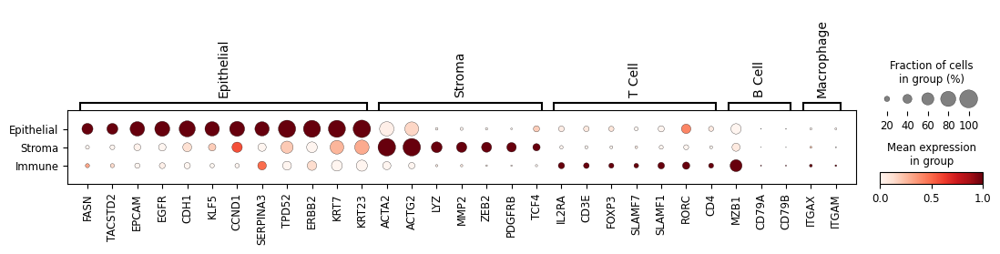

In [49]:
sc.pl.dotplot(ad_xen, marker_genes, 
              groupby="cell_type", 
              standard_scale="var"
             )

/condo/wanglab/hmaiwxc/anaconda3/envs/clip/lib/python3.9/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c


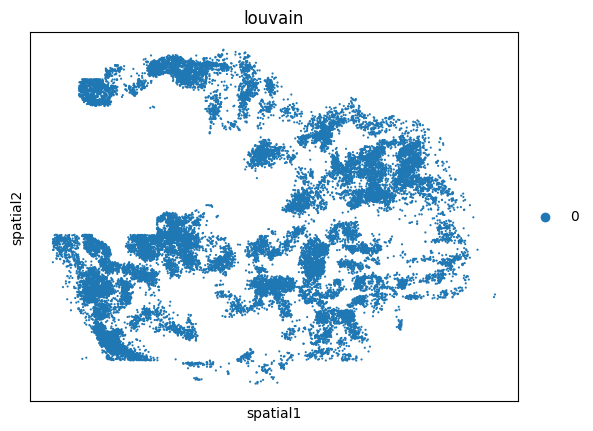

/condo/wanglab/hmaiwxc/anaconda3/envs/clip/lib/python3.9/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c


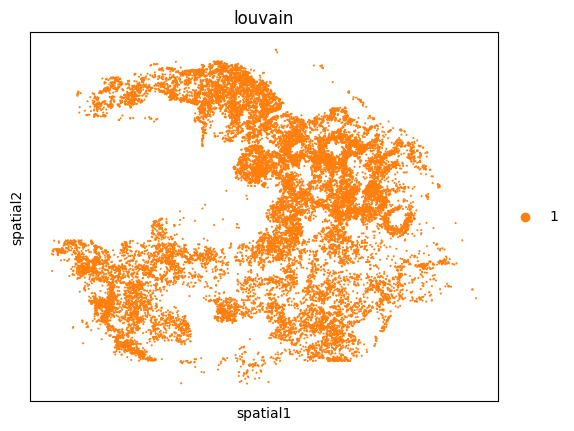

/condo/wanglab/hmaiwxc/anaconda3/envs/clip/lib/python3.9/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c


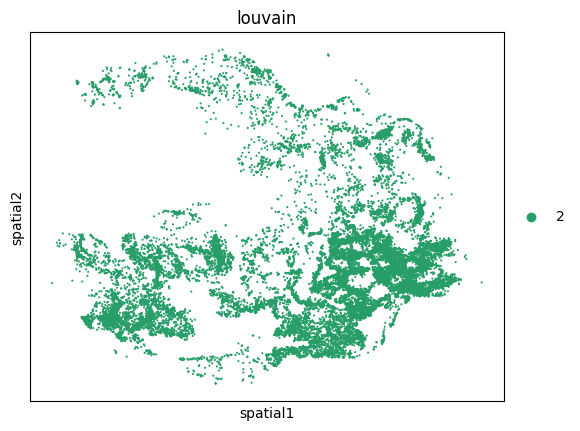

/condo/wanglab/hmaiwxc/anaconda3/envs/clip/lib/python3.9/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c


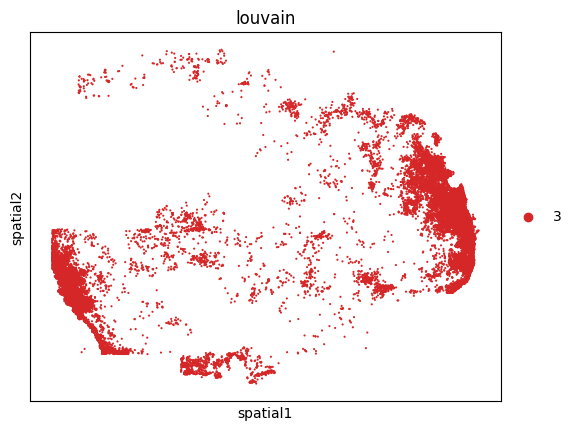

/condo/wanglab/hmaiwxc/anaconda3/envs/clip/lib/python3.9/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c


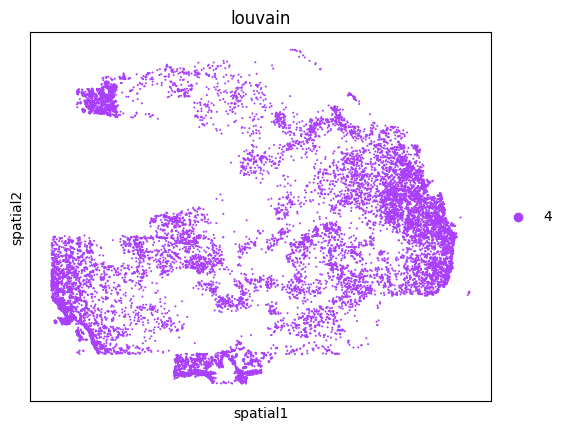

/condo/wanglab/hmaiwxc/anaconda3/envs/clip/lib/python3.9/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c


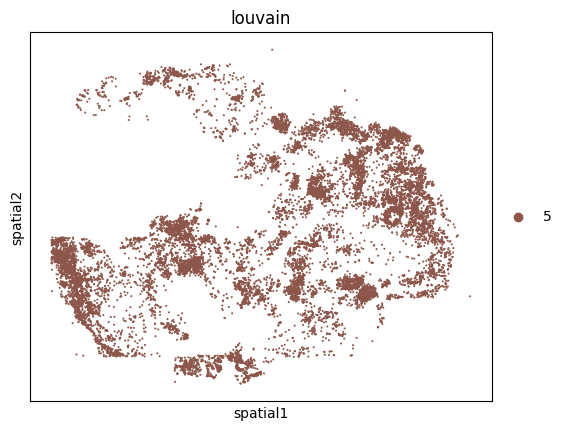

/condo/wanglab/hmaiwxc/anaconda3/envs/clip/lib/python3.9/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c


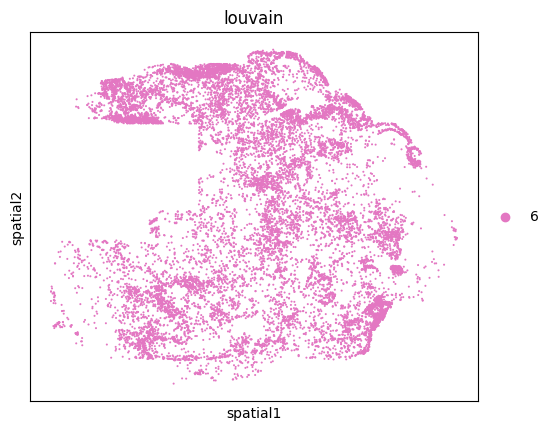

/condo/wanglab/hmaiwxc/anaconda3/envs/clip/lib/python3.9/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c


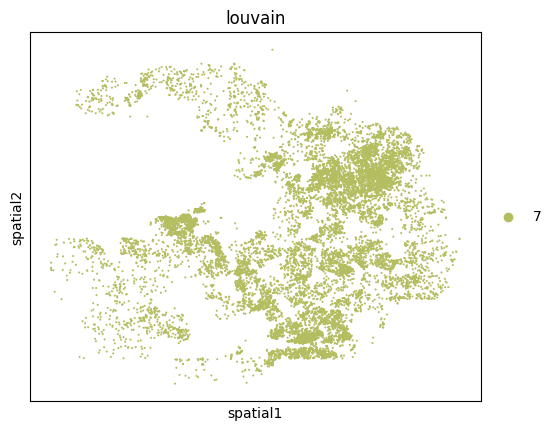

/condo/wanglab/hmaiwxc/anaconda3/envs/clip/lib/python3.9/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c


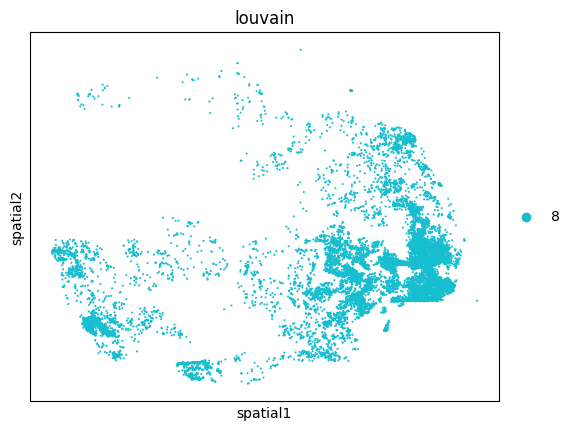

/condo/wanglab/hmaiwxc/anaconda3/envs/clip/lib/python3.9/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c


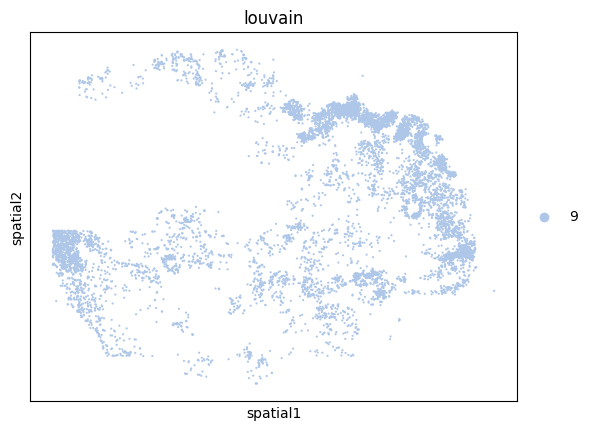

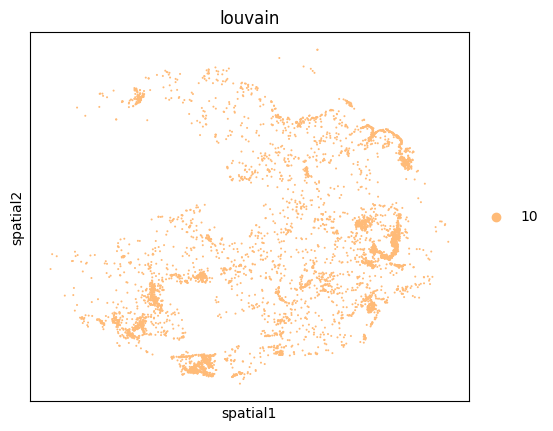

In [145]:
for i in range(11):
    sc.pl.spatial(ad_xen[ad_xen.obs['louvain']==str(i)], color='louvain', alpha_img=0, spot_size=200)

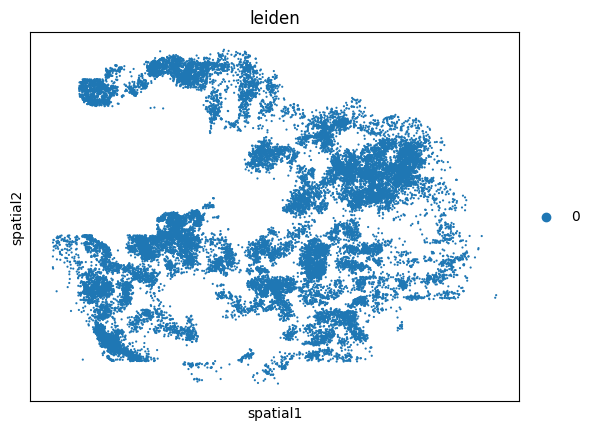

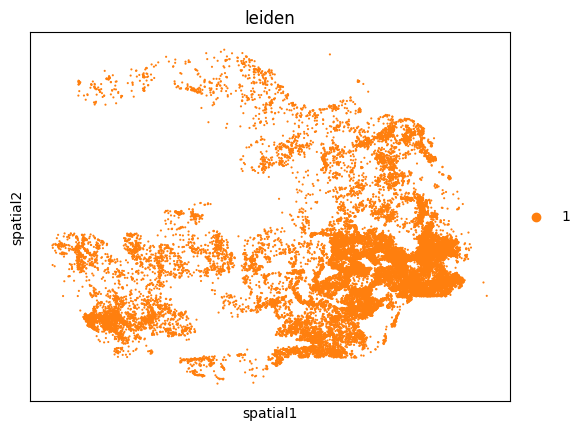

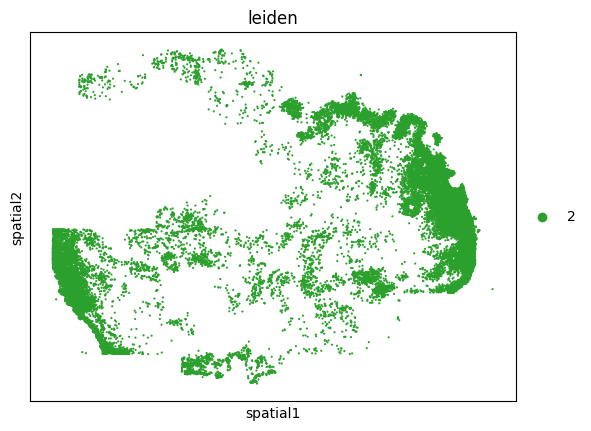

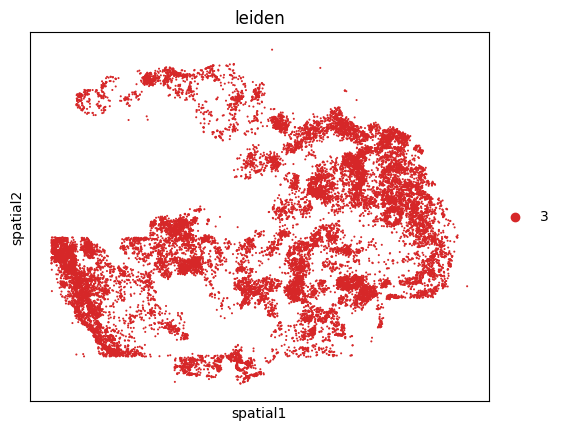

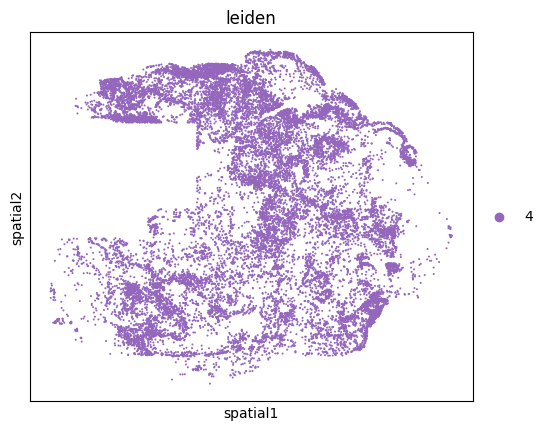

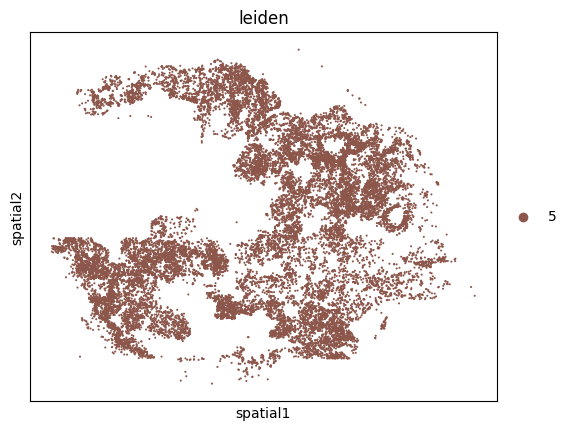

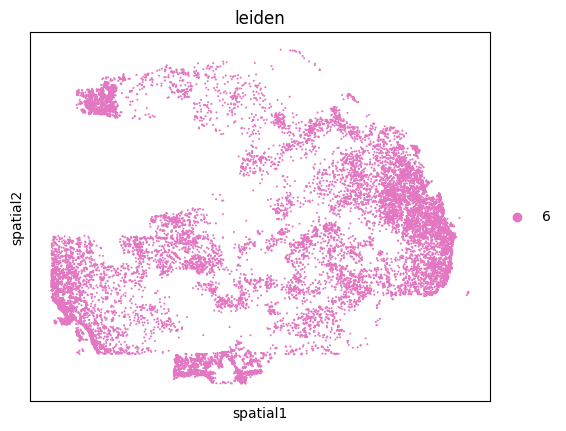

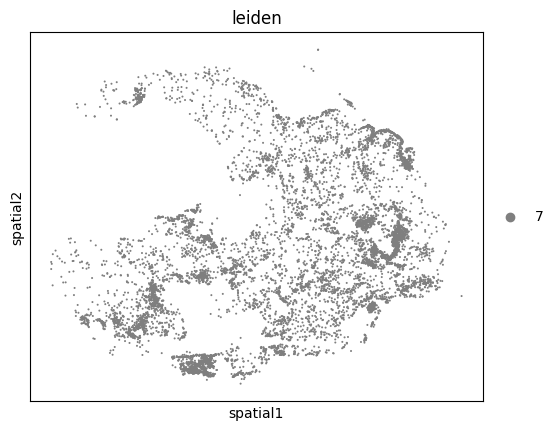

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


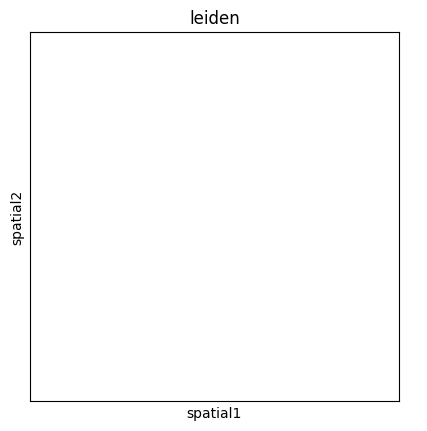

In [139]:
for i in range(9):
    sc.pl.spatial(ad_xen[ad_xen.obs['leiden']==str(i)], color='leiden', alpha_img=0, spot_size=200)

In [140]:
sc.tl.rank_genes_groups(ad_xen, 
                        groupby='louvain',
                        # method='wilcoxon'
                       )

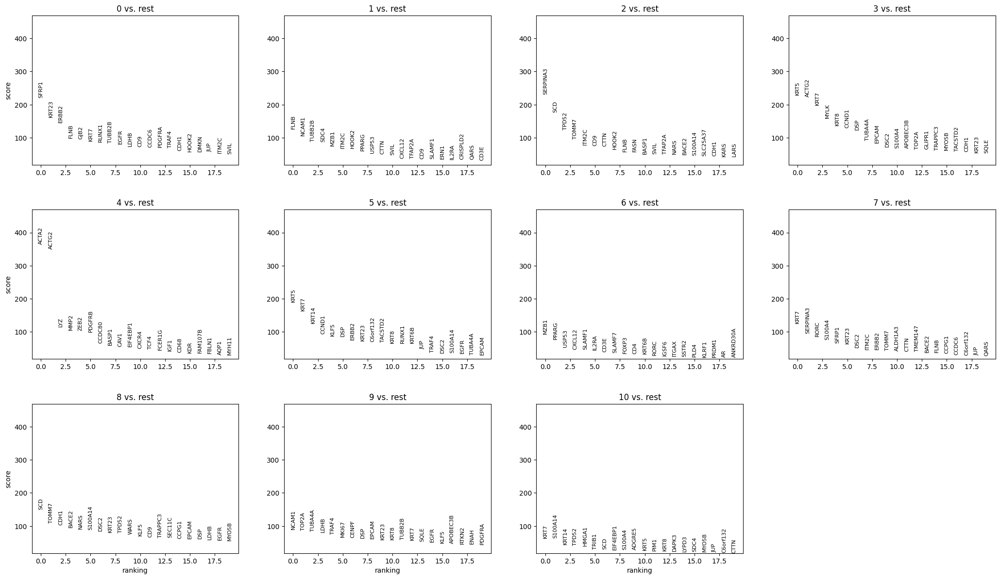

In [141]:
sc.pl.rank_genes_groups(ad_xen)

In [142]:
sc.tl.dendrogram(ad_xen, 
                 groupby="louvain"
                )

/condo/wanglab/hmaiwxc/anaconda3/envs/clip/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


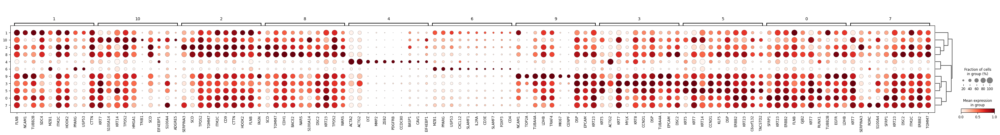

In [143]:
sc.pl.rank_genes_groups_dotplot(
    ad_xen, 
    groupby="louvain", 
    standard_scale="var", 
    n_genes=10
)

In [146]:
ad_xen.obs["cell_type_lv"] = ad_xen.obs["louvain"].map(
    {
        "0": "Epithelial3",
        "1": "Epithelial1",
        "2": "Epithelial1",
        "3": "Epithelial2",        
        "4": "Stroma",
        "5": "Epithelial2",  
        "6": "Immune",  
        "7": "Epithelial3",
        "8": "Epithelial1",
        "9": "Epithelial2",
        "10": "Epithelial1",
    }
)

In [147]:
ad_xen.obs["cell_type"] = ad_xen.obs["cell_type_lv"].map(
    {
        "Epithelial1": "Epithelial",
        "Epithelial2": "Epithelial",
        "Epithelial3": "Epithelial",        
        "Stroma": "Stroma",
        "Immune": "Immune",  
    }
)

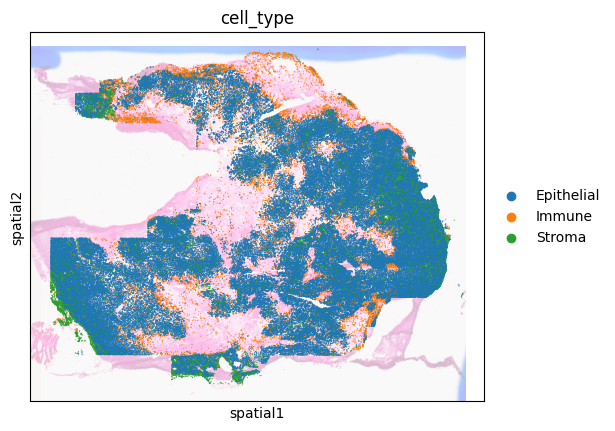

In [148]:
sc.pl.spatial(ad_xen, color='cell_type', alpha_img=0.3, spot_size=100)

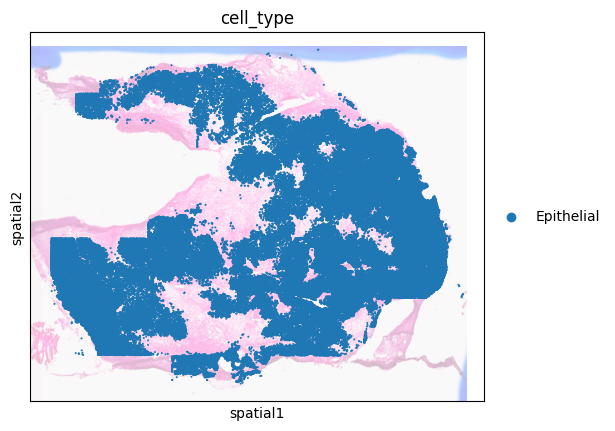

In [153]:
sc.pl.spatial(ad_xen[ad_xen.obs['cell_type']=='Epithelial'], color='cell_type', alpha_img=0.3, spot_size=200)

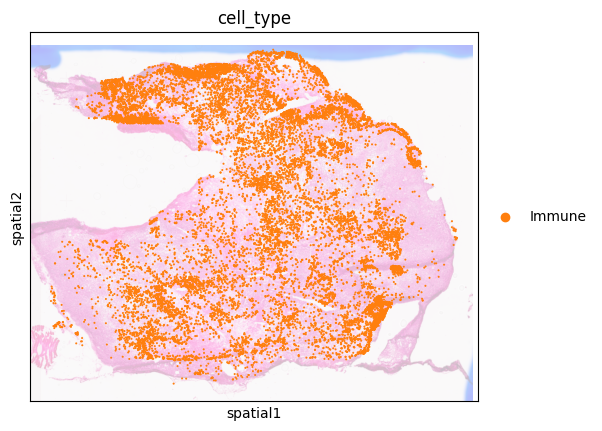

In [149]:
sc.pl.spatial(ad_xen[ad_xen.obs['cell_type']=='Immune'], color='cell_type', alpha_img=0.3, spot_size=200)

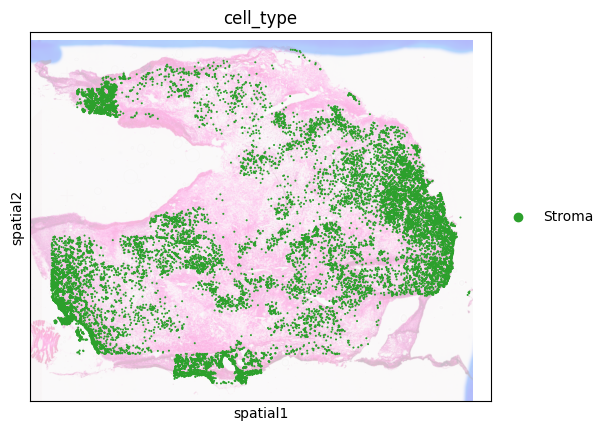

In [150]:
sc.pl.spatial(ad_xen[ad_xen.obs['cell_type']=='Stroma'], color='cell_type', alpha_img=0.3, spot_size=200)

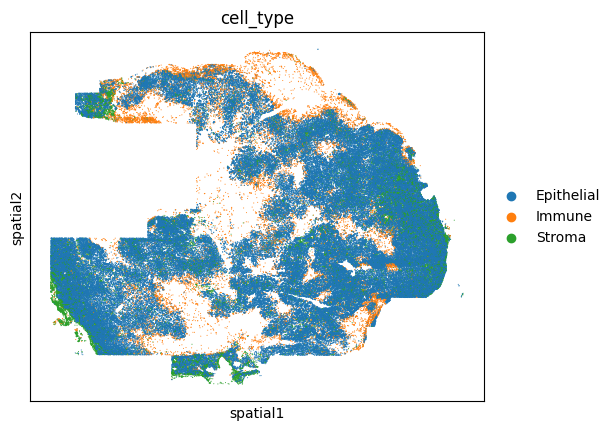

In [151]:
sc.pl.spatial(ad_xen, color='cell_type', alpha_img=0, spot_size=100)

In [152]:
ad_xen.obs

,in_tissue,n_counts,leiden,louvain,cell_type_lv,cell_type
aaaadjeh-1,1,243.0,1,8,Epithelial1,Epithelial
aaaafmll-1,1,295.0,2,8,Epithelial1,Epithelial
aaaahcpb-1,1,207.0,1,8,Epithelial1,Epithelial
aaaaibfe-1,1,140.0,2,3,Epithelial2,Epithelial
aaaajcfe-1,1,235.0,2,3,Epithelial2,Epithelial
...,...,...,...,...,...,...
oilfamde-1,1,144.0,0,0,Epithelial3,Epithelial
oilfccnd-1,1,441.0,0,0,Epithelial3,Epithelial
oilfhkkg-1,1,187.0,0,0,Epithelial3,Epithelial
oilgaoff-1,1,158.0,0,0,Epithelial3,Epithelial


In [154]:
ad_xen.write_h5ad('/condo/wanglab/shared/wxc/clip/data/human/HM_data/TNBC_Xenium_anno.h5ad')

## Polygon

In [79]:
ad_xen = sc.read_h5ad('/condo/wanglab/shared/wxc/clip/data/human/HM_data/TNBC_Xenium_anno.h5ad')

In [80]:
ad_xen.obs["cell_type_color"] = ad_xen.obs["cell_type"].map(
    {
        "Epithelial": "red",
        "Stroma": "blue",
        "Immune": "green",
    }
)

In [81]:
xen_coor = ad_xen.obsm['spatial']

In [82]:
boundary_path='/condo/wanglab/shared/wxc/clip/data/human/HM_data/TNBC/Xenium_Explorer/nucleus_boundaries.parquet'

In [101]:
boundary_df = pd.read_parquet(boundary_path)

In [102]:
boundary_df

,cell_id,vertex_x,vertex_y,label_id
0,aaaadjeh-1,1036.575073,2233.800049,1
1,aaaadjeh-1,1035.724976,2234.225098,1
2,aaaadjeh-1,1034.875000,2234.437500,1
3,aaaadjeh-1,1034.025024,2234.437500,1
4,aaaadjeh-1,1033.812500,2234.650146,1
...,...,...,...,...
4714349,oilgbcik-1,3428.687500,5122.737793,189598
4714350,oilgbcik-1,3428.475098,5122.737793,189598
4714351,oilgbcik-1,3427.625000,5121.887695,189598
4714352,oilgbcik-1,3427.200195,5121.675293,189598


In [103]:
# boundary_df['vertex_y'] = -boundary_df['vertex_y']

In [86]:
boundary_df

,cell_id,vertex_x,vertex_y,label_id
0,aaaadjeh-1,1036.575073,-2233.800049,1
1,aaaadjeh-1,1035.724976,-2234.225098,1
2,aaaadjeh-1,1034.875000,-2234.437500,1
3,aaaadjeh-1,1034.025024,-2234.437500,1
4,aaaadjeh-1,1033.812500,-2234.650146,1
...,...,...,...,...
4714349,oilgbcik-1,3428.687500,-5122.737793,189598
4714350,oilgbcik-1,3428.475098,-5122.737793,189598
4714351,oilgbcik-1,3427.625000,-5121.887695,189598
4714352,oilgbcik-1,3427.200195,-5121.675293,189598


### ROI1

In [120]:
left=26000
right=31000
top=18000
bottom=22000
crop_coord = [left, right, top, bottom]

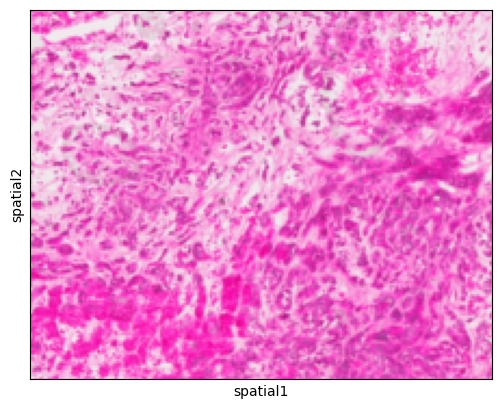

In [121]:
sc.pl.spatial(ad_xen, crop_coord = crop_coord, img_key='hires')

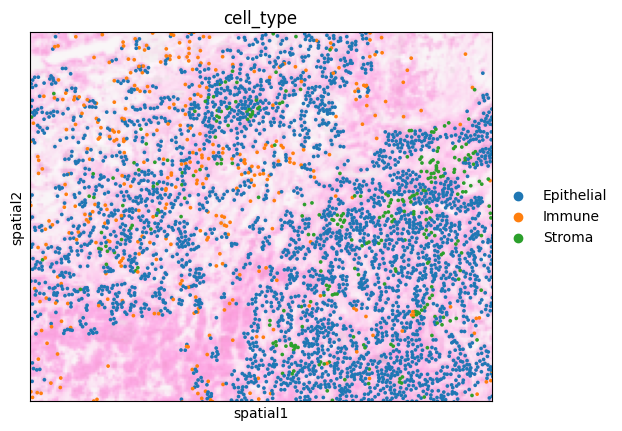

In [134]:
sc.pl.spatial(ad_xen, color='cell_type', crop_coord = crop_coord, img_key='hires', spot_size=40, alpha_img=0.4)

In [123]:
mask = (xen_coor[:, 0] >= left) & (xen_coor[:, 0] <= right) & \
                         (xen_coor[:, 1] >= top) & (xen_coor[:, 1] <= bottom)

In [124]:
sele_cells = ad_xen.obs.iloc[np.where(mask)[0]].index.tolist()
len(sele_cells)

3944

In [125]:
sele_cells_epi = ad_xen.obs[ad_xen.obs.index.isin(sele_cells)][ad_xen.obs['cell_type']=='Epithelial'].index.tolist()
len(sele_cells_epi)

/tmp/ipykernel_154662/1111805789.py:1: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  sele_cells_epi = ad_xen.obs[ad_xen.obs.index.isin(sele_cells)][ad_xen.obs['cell_type']=='Epithelial'].index.tolist()


3282

In [126]:
sele_cells_imm = ad_xen.obs[ad_xen.obs.index.isin(sele_cells)][ad_xen.obs['cell_type']=='Immune'].index.tolist()
len(sele_cells_imm)

/tmp/ipykernel_154662/3374050169.py:1: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  sele_cells_imm = ad_xen.obs[ad_xen.obs.index.isin(sele_cells)][ad_xen.obs['cell_type']=='Immune'].index.tolist()


371

In [127]:
sele_cells_str = ad_xen.obs[ad_xen.obs.index.isin(sele_cells)][ad_xen.obs['cell_type']=='Stroma'].index.tolist()
len(sele_cells_str)

/tmp/ipykernel_154662/890136547.py:1: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  sele_cells_str = ad_xen.obs[ad_xen.obs.index.isin(sele_cells)][ad_xen.obs['cell_type']=='Stroma'].index.tolist()


291

In [128]:
boundary_df_sele = boundary_df[boundary_df['cell_id'].isin(sele_cells)]

100%|██████████| 3944/3944 [00:25<00:00, 157.50it/s]


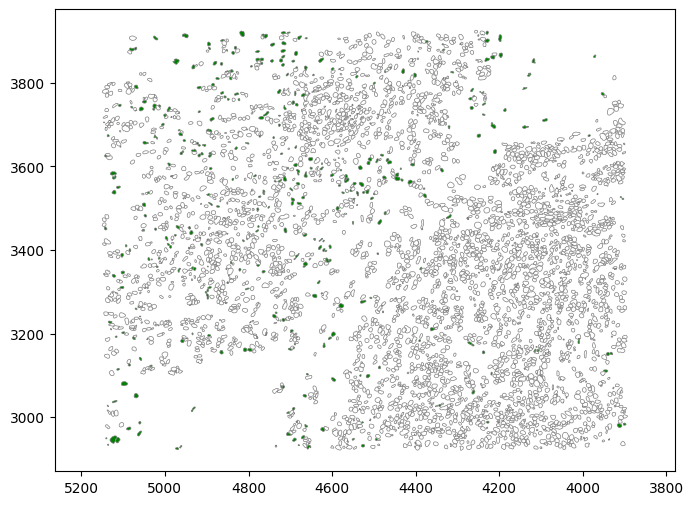

In [129]:
plt.figure(figsize=(8, 6))

for cell in tqdm(sele_cells):
    cell_data = boundary_df_sele[boundary_df_sele['cell_id'] == cell]
    cell_color = 'white'
    if cell in sele_cells_imm: 
        cell_color = ad_xen.obs[ad_xen.obs.index==cell]['cell_type_color'][0]
    polygon = plt.Polygon(cell_data[['vertex_x', 'vertex_y']].values, closed=True, 
                          facecolor=cell_color,
                          edgecolor='grey', 
                          linewidth=0.5)
    plt.gca().add_patch(polygon)

plt.axis('equal')  # Set equal scaling
plt.gca().invert_xaxis()
plt.show()

100%|██████████| 3944/3944 [00:22<00:00, 173.95it/s]


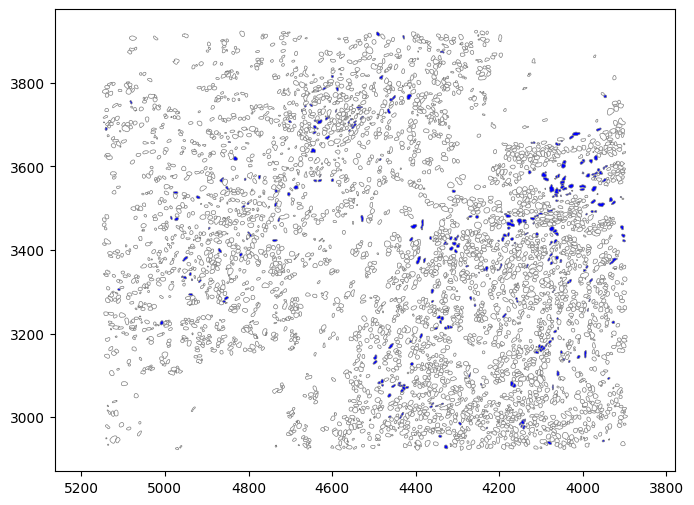

In [130]:
plt.figure(figsize=(8, 6))

for cell in tqdm(sele_cells):
    cell_data = boundary_df_sele[boundary_df_sele['cell_id'] == cell]
    cell_color = 'white'
    if cell in sele_cells_str: 
        cell_color = ad_xen.obs[ad_xen.obs.index==cell]['cell_type_color'][0]
    polygon = plt.Polygon(cell_data[['vertex_x', 'vertex_y']].values, closed=True, 
                          facecolor=cell_color,
                          edgecolor='grey', 
                          linewidth=0.5)
    plt.gca().add_patch(polygon)

plt.axis('equal')  # Set equal scaling
plt.gca().invert_xaxis()
plt.show()

100%|██████████| 3944/3944 [00:46<00:00, 83.94it/s] 


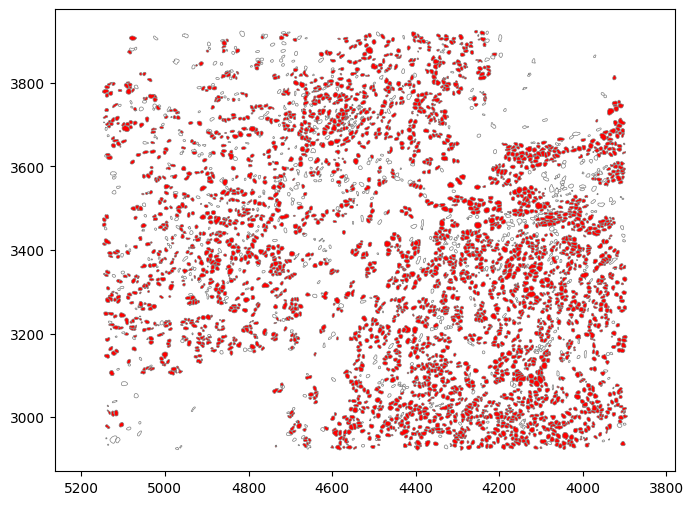

In [131]:
plt.figure(figsize=(8, 6))

for cell in tqdm(sele_cells):
    cell_data = boundary_df_sele[boundary_df_sele['cell_id'] == cell]
    cell_color = 'white'
    if cell in sele_cells_epi: 
        cell_color = ad_xen.obs[ad_xen.obs.index==cell]['cell_type_color'][0]
    polygon = plt.Polygon(cell_data[['vertex_x', 'vertex_y']].values, closed=True, 
                          facecolor=cell_color,
                          edgecolor='grey', 
                          linewidth=0.5)
    plt.gca().add_patch(polygon)

plt.axis('equal')  # Set equal scaling
plt.gca().invert_xaxis()
plt.show()

100%|██████████| 3944/3944 [00:53<00:00, 73.72it/s]


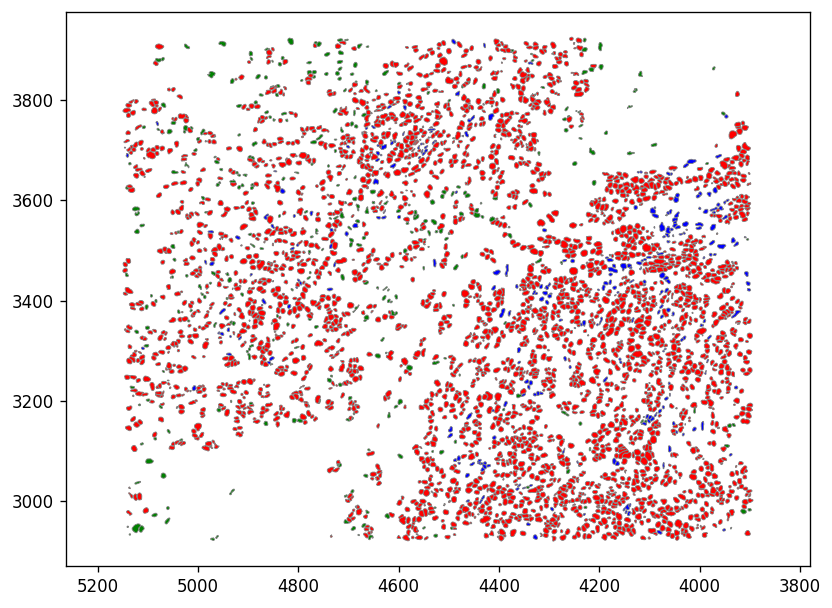

In [132]:
plt.figure(figsize=(8, 6), dpi=120)

for cell in tqdm(sele_cells):
    cell_data = boundary_df_sele[boundary_df_sele['cell_id'] == cell]
    cell_color = ad_xen.obs[ad_xen.obs.index==cell]['cell_type_color'][0]
    polygon = plt.Polygon(cell_data[['vertex_x', 'vertex_y']].values, closed=True, 
                          facecolor=cell_color,
                          edgecolor='grey', 
                          linewidth=0.5)
    plt.gca().add_patch(polygon)

plt.axis('equal')  # Set equal scaling
plt.gca().invert_xaxis()
plt.show()

### ROI2

In [67]:
left=26000+5000
right=31000+5000
top=18000+5000
bottom=22000+5000
crop_coord = [left, right, top, bottom]

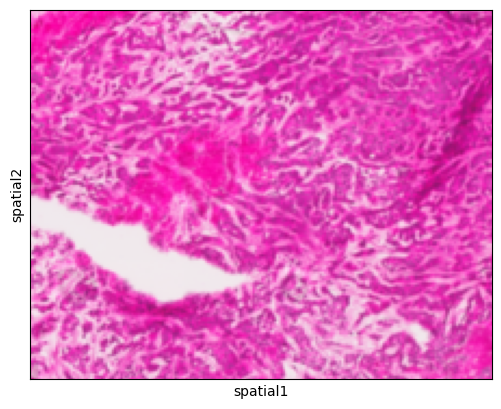

In [68]:
sc.pl.spatial(ad_xen, crop_coord = crop_coord)

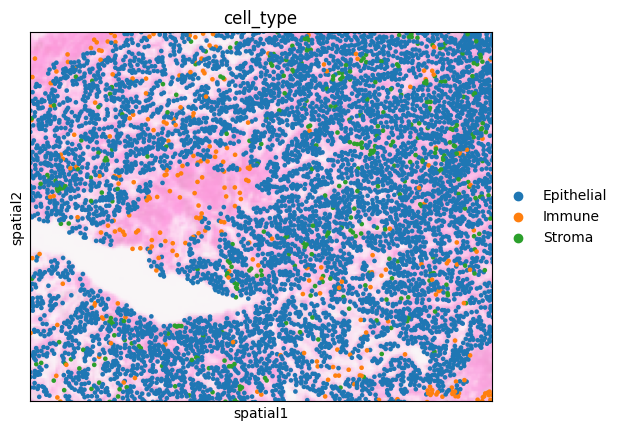

In [69]:
sc.pl.spatial(ad_xen, color='cell_type', crop_coord = crop_coord, spot_size=50, alpha_img=0.4)

In [87]:
mask = (xen_coor[:, 0] >= left) & (xen_coor[:, 0] <= right) & \
                         (xen_coor[:, 1] >= top) & (xen_coor[:, 1] <= bottom)

In [71]:
sele_cells = ad_xen.obs.iloc[np.where(mask)[0]].index.tolist()
len(sele_cells)

6913

In [72]:
sele_cells_epi = ad_xen.obs[ad_xen.obs.index.isin(sele_cells)][ad_xen.obs['cell_type']=='Epithelial'].index.tolist()
len(sele_cells_epi)

/tmp/ipykernel_154662/1111805789.py:1: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  sele_cells_epi = ad_xen.obs[ad_xen.obs.index.isin(sele_cells)][ad_xen.obs['cell_type']=='Epithelial'].index.tolist()


6296

In [73]:
sele_cells_imm = ad_xen.obs[ad_xen.obs.index.isin(sele_cells)][ad_xen.obs['cell_type']=='Immune'].index.tolist()
len(sele_cells_imm)

/tmp/ipykernel_154662/3374050169.py:1: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  sele_cells_imm = ad_xen.obs[ad_xen.obs.index.isin(sele_cells)][ad_xen.obs['cell_type']=='Immune'].index.tolist()


275

In [74]:
sele_cells_str = ad_xen.obs[ad_xen.obs.index.isin(sele_cells)][ad_xen.obs['cell_type']=='Stroma'].index.tolist()
len(sele_cells_str)

/tmp/ipykernel_154662/890136547.py:1: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  sele_cells_str = ad_xen.obs[ad_xen.obs.index.isin(sele_cells)][ad_xen.obs['cell_type']=='Stroma'].index.tolist()


342

In [104]:
boundary_df_sele = boundary_df[boundary_df['cell_id'].isin(sele_cells)]

In [105]:
boundary_df_sele

,cell_id,vertex_x,vertex_y,label_id
1215533,dmaegmno-1,3096.550049,1715.512573,48844
1215534,dmaegmno-1,3096.337646,1715.725098,48844
1215535,dmaegmno-1,3094.850098,1715.725098,48844
1215536,dmaegmno-1,3094.425049,1715.937500,48844
1215537,dmaegmno-1,3093.362549,1717.850098,48844
...,...,...,...,...
3872327,lompigdo-1,3894.912598,2220.412598,155660
3872328,lompigdo-1,3894.062500,2220.199951,155660
3872329,lompigdo-1,3893.850098,2219.987549,155660
3872330,lompigdo-1,3892.575195,2219.987549,155660


100%|██████████| 6913/6913 [01:16<00:00, 90.33it/s] 


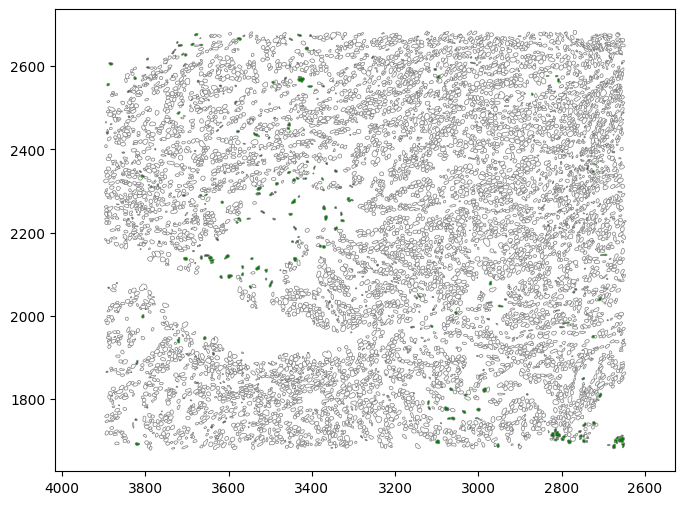

In [119]:
plt.figure(figsize=(8, 6))

for cell in tqdm(sele_cells):
    cell_data = boundary_df_sele[boundary_df_sele['cell_id'] == cell]
    cell_color = 'white'
    if cell in sele_cells_imm: 
        cell_color = ad_xen.obs[ad_xen.obs.index==cell]['cell_type_color'][0]
    polygon = plt.Polygon(cell_data[['vertex_x', 'vertex_y']].values, closed=True, 
                          facecolor=cell_color,
                          edgecolor='grey', 
                          linewidth=0.5)
    plt.gca().add_patch(polygon)

plt.axis('equal')  # Set equal scaling
plt.gca().invert_xaxis()
plt.show()

100%|██████████| 6913/6913 [00:59<00:00, 115.38it/s]


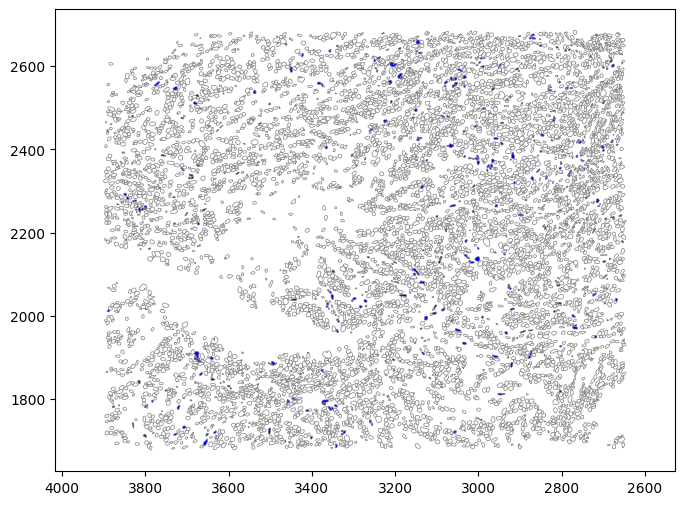

In [118]:
plt.figure(figsize=(8, 6))

for cell in tqdm(sele_cells):
    cell_data = boundary_df_sele[boundary_df_sele['cell_id'] == cell]
    cell_color = 'white'
    if cell in sele_cells_str: 
        cell_color = ad_xen.obs[ad_xen.obs.index==cell]['cell_type_color'][0]
    polygon = plt.Polygon(cell_data[['vertex_x', 'vertex_y']].values, closed=True, 
                          facecolor=cell_color,
                          edgecolor='grey', 
                          linewidth=0.5)
    plt.gca().add_patch(polygon)

plt.axis('equal')  # Set equal scaling
plt.gca().invert_xaxis()
plt.show()

100%|██████████| 6913/6913 [01:51<00:00, 62.17it/s]


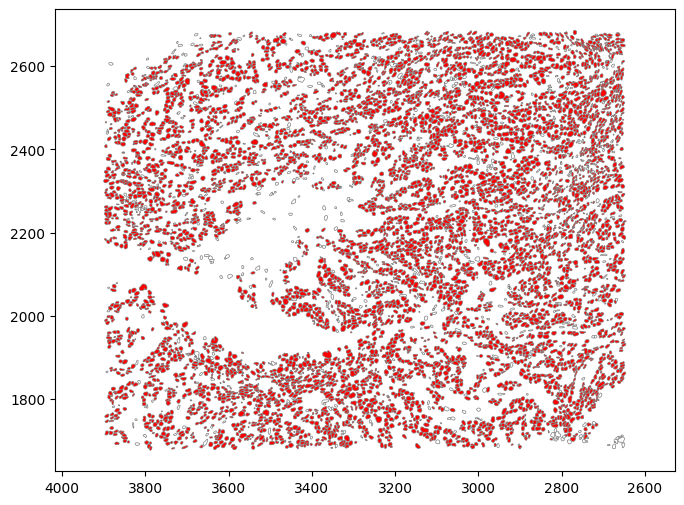

In [117]:
plt.figure(figsize=(8, 6))

for cell in tqdm(sele_cells):
    cell_data = boundary_df_sele[boundary_df_sele['cell_id'] == cell]
    cell_color = 'white'
    if cell in sele_cells_epi: 
        cell_color = ad_xen.obs[ad_xen.obs.index==cell]['cell_type_color'][0]
    polygon = plt.Polygon(cell_data[['vertex_x', 'vertex_y']].values, closed=True, 
                          facecolor=cell_color,
                          edgecolor='grey', 
                          linewidth=0.5)
    plt.gca().add_patch(polygon)

plt.axis('equal')  # Set equal scaling
plt.gca().invert_xaxis()
plt.show()

100%|██████████| 6913/6913 [01:57<00:00, 58.93it/s]


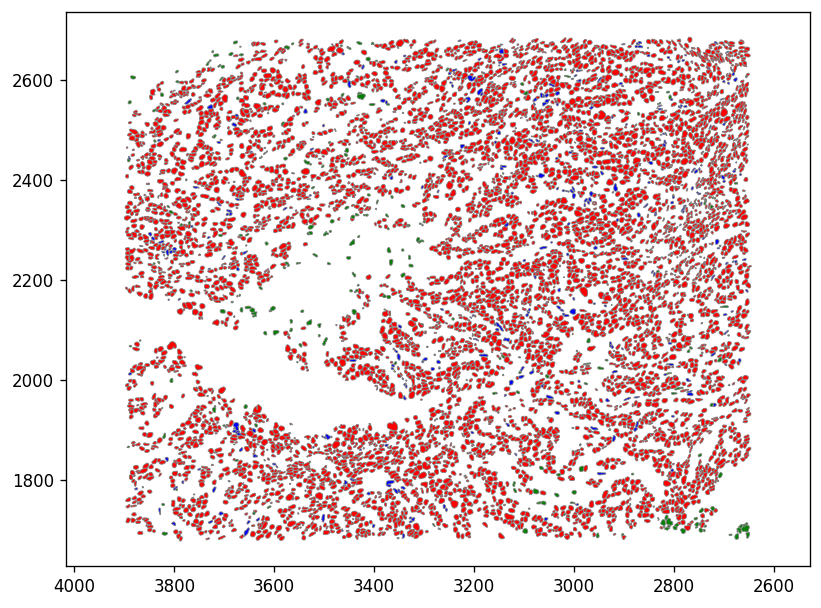

In [108]:
plt.figure(figsize=(8, 6), dpi=120)

for cell in tqdm(sele_cells):
    cell_data = boundary_df_sele[boundary_df_sele['cell_id'] == cell]
    cell_color = ad_xen.obs[ad_xen.obs.index==cell]['cell_type_color'][0]
    polygon = plt.Polygon(cell_data[['vertex_x', 'vertex_y']].values, closed=True, 
                          facecolor=cell_color,
                          edgecolor='grey', 
                          linewidth=0.5)
    plt.gca().add_patch(polygon)

plt.axis('equal')  # Set equal scaling
plt.gca().invert_xaxis()
plt.show()

## Align cell to spot

In [91]:
from scipy.spatial import KDTree

def find_points_within_radius_fast(grid_set, point_set, radius):
    # Convert sets to numpy arrays for compatibility with KDTree
    setA = np.array(point_set)
    setB = np.array(grid_set)
    
    # Build a KD-Tree for setB
    tree_B = KDTree(setB)
    tree_A = KDTree(setA)
    
    # List to collect pairs of indices
    pairs = []
    
    # Array to store the count of setA points within the radius for each point in setB
    count_in_radius = np.zeros(len(setB), dtype=int)
    
    # Query the tree to find indices of points in setB within the radius of each point in setA
    for i, pointA in enumerate(setA):
        indices = tree_B.query_ball_point(pointA, r=radius)
        for j in indices:
            pairs.append([i, j])
    
    # Calculate the number of setA points within the radius for each point in setB
    for j, pointB in enumerate(setB):
        indices = tree_A.query_ball_point(pointB, r=radius)
        count_in_radius[j] = len(indices)
    
    # Convert the list of pairs to a 2D numpy array
    pairs_array = np.array(pairs)
    
    return pairs_array, count_in_radius

In [104]:
ad = sc.read_h5ad(data_path+sample_name+'.h5ad')

In [105]:
ad

AnnData object with n_obs × n_vars = 4168 × 18085
    obs: 'in_tissue', 'array_row', 'array_col', 'pixel_y', 'pixel_x', 'cell_num'
    var: 'gene_ids', 'feature_types', 'genome'
    uns: 'spatial'
    obsm: 'spatial'

In [106]:
ad.var.index.duplicated().sum()

0

In [112]:
library_id = get_library_id(ad)
spot_diameter_fullres = ad.uns['spatial'][library_id]['scalefactors']['spot_diameter_fullres']

In [113]:
spot_diameter_fullres

281.3237428049849

In [92]:
ad_xen = sc.read_h5ad('/condo/wanglab/shared/wxc/clip/data/human/HM_data/TNBC_Xenium_raw.h5ad')

In [93]:
ad_xen

AnnData object with n_obs × n_vars = 189598 × 280
    obs: 'in_tissue'
    var: 'gene_ids', 'feature_types'
    uns: 'spatial'
    obsm: 'spatial'

In [115]:
grid_set = ad.obsm['spatial']
point_set = ad_xen.obsm['spatial']
radius = spot_diameter_fullres/2

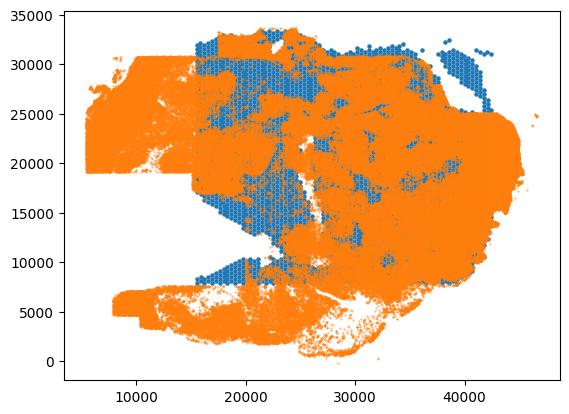

In [95]:
plt.scatter(grid_set[:,0],grid_set[:,1],s=5)
plt.scatter(point_set[:,0],point_set[:,1],s=0.1)

In [96]:
pairs, counts = find_points_within_radius_fast(grid_set, point_set, radius)

In [97]:
pairs.shape

(54667, 2)

In [98]:
pairs

array([[     5,    242],
       [     6,    242],
       [     7,    242],
       ...,
       [189593,     35],
       [189595,     35],
       [189597,     35]])

In [99]:
counts.shape

(4168,)

In [349]:
ad_xen.obs['spot']=None

In [350]:
ad_xen.obs

,in_tissue,spot
aaaadjeh-1,1,None
aaaafmll-1,1,None
aaaahcpb-1,1,None
aaaaibfe-1,1,None
aaaajcfe-1,1,None
...,...,...
oilfamde-1,1,None
oilfccnd-1,1,None
oilfhkkg-1,1,None
oilgaoff-1,1,None


In [352]:
ad_xen.obs.iloc[pairs[:,0], 1]=ad.obs.iloc[pairs[:,1]].index

In [353]:
ad_xen.obs

,in_tissue,spot
aaaadjeh-1,1,None
aaaafmll-1,1,None
aaaahcpb-1,1,None
aaaaibfe-1,1,None
aaaajcfe-1,1,None
...,...,...
oilfamde-1,1,TNBC_processed_adata_AACGAGCTAATAACTA-1
oilfccnd-1,1,None
oilfhkkg-1,1,TNBC_processed_adata_AACGAGCTAATAACTA-1
oilgaoff-1,1,None


In [354]:
ad_xen.write_h5ad('/condo/wanglab/shared/wxc/clip/data/human/HM_data/TNBC_Xenium.h5ad')

In [355]:
ad_xen

AnnData object with n_obs × n_vars = 189598 × 280
    obs: 'in_tissue', 'spot'
    var: 'gene_ids', 'feature_types'
    uns: 'spatial'
    obsm: 'spatial'

In [357]:
ad_xen_sp = ad_xen[ad_xen.obs.dropna().index]

In [358]:
ad_xen_sp

View of AnnData object with n_obs × n_vars = 54667 × 280
    obs: 'in_tissue', 'spot'
    var: 'gene_ids', 'feature_types'
    uns: 'spatial'
    obsm: 'spatial'

In [361]:
ad_xen_sp.write_h5ad('/condo/wanglab/shared/wxc/clip/data/human/HM_data/TNBC_Xenium_spot.h5ad')

In [117]:
ad.var.index.duplicated().sum()

0

In [118]:
ad.obs['cell_num']=counts

In [119]:
ad.obs

,in_tissue,array_row,array_col,pixel_y,pixel_x,cell_num
TNBC_processed_adata_AACACGTGCATCGCAC-1,1,76,22,15870,28972,1
TNBC_processed_adata_AACACTTGGCAAGGAA-1,1,47,71,26019,19136,12
TNBC_processed_adata_AACAGGAAGAGCATAG-1,1,69,7,18314,31989,22
TNBC_processed_adata_AACAGGATTCATAGTT-1,1,49,43,25314,24762,24
TNBC_processed_adata_AACAGGCCAACGATTA-1,1,71,127,17639,7875,0
...,...,...,...,...,...,...
TNBC_processed_adata_TGTTGGAACCTTCCGC-1,1,35,35,30208,26374,30
TNBC_processed_adata_TGTTGGAACGAGGTCA-1,1,28,72,32663,18942,32
TNBC_processed_adata_TGTTGGAAGCTCGGTA-1,1,1,95,42108,14329,29
TNBC_processed_adata_TGTTGGATGGACTTCT-1,1,13,53,37904,22765,9


In [120]:
ad

AnnData object with n_obs × n_vars = 4168 × 18085
    obs: 'in_tissue', 'array_row', 'array_col', 'pixel_y', 'pixel_x', 'cell_num'
    var: 'gene_ids', 'feature_types', 'genome'
    uns: 'spatial'
    obsm: 'spatial'

In [121]:
ad.var.index.duplicated().sum()

0

In [122]:
ad.write_h5ad(data_path+sample_name+'_cell_num.h5ad')

## QC

In [70]:
ad_xen_sp = sc.read_h5ad('/condo/wanglab/shared/wxc/clip/data/human/HM_data/TNBC_Xenium_spot.h5ad')

In [71]:
ad_xen_sp

AnnData object with n_obs × n_vars = 54667 × 280
    obs: 'in_tissue', 'spot'
    var: 'gene_ids', 'feature_types'
    uns: 'spatial'
    obsm: 'spatial'

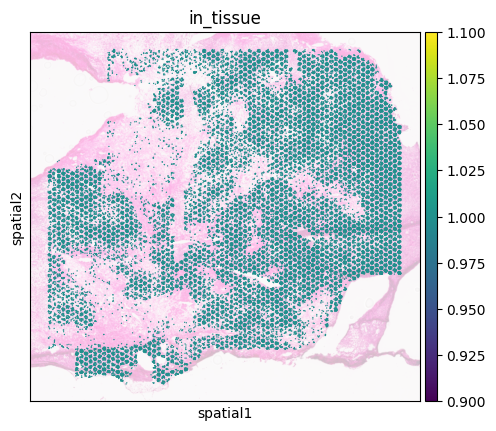

In [72]:
sc.pl.spatial(ad_xen_sp, color='in_tissue', alpha_img=0.3,spot_size=100)

In [73]:
ad_xen_sp.layers["counts"] = ad_xen_sp.X.copy()

In [74]:
sc.pp.filter_cells(ad_xen_sp, min_counts=10)

In [75]:
ad_xen_sp

AnnData object with n_obs × n_vars = 54102 × 280
    obs: 'in_tissue', 'spot', 'n_counts'
    var: 'gene_ids', 'feature_types'
    uns: 'spatial'
    obsm: 'spatial'
    layers: 'counts'

In [76]:
sc.pp.normalize_total(ad_xen_sp)
sc.pp.log1p(ad_xen_sp)

In [77]:
sc.pp.pca(ad_xen_sp)

In [78]:
sc.pp.neighbors(ad_xen_sp)
# sc.pp.neighbors(ad_xen_sp, n_neighbors=20)

In [79]:
# sc.tl.leiden(ad_xen_sp, resolution=1.3)
sc.tl.leiden(ad_xen_sp)

In [80]:
# sc.tl.umap(ad_xen_sp)
sc.tl.umap(ad_xen_sp, min_dist=0.1)

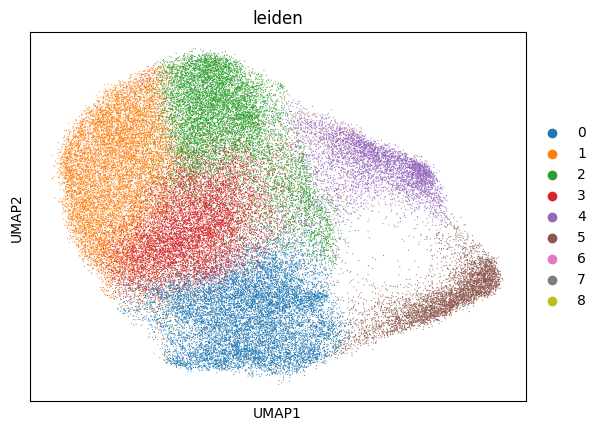

In [81]:
sc.pl.umap(ad_xen_sp, color='leiden', color_map='tab10')

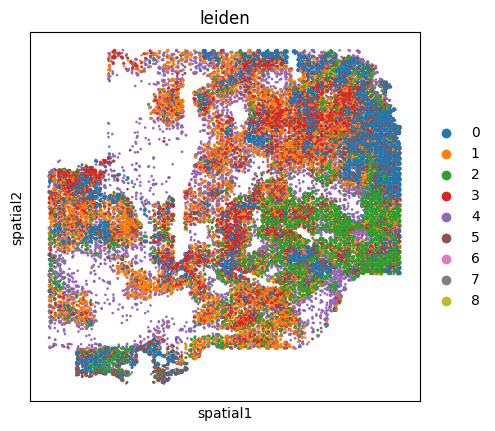

In [82]:
sc.pl.spatial(ad_xen_sp, color='leiden', alpha_img=0, spot_size=200)

In [83]:
sc.tl.tsne(ad_xen_sp)

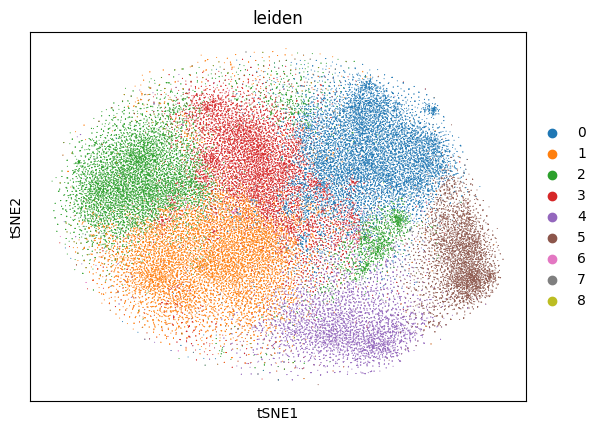

In [84]:
sc.pl.tsne(ad_xen_sp, color='leiden')

In [85]:
# sc.tl.louvain(ad_xen_sp, resolution=1.4)
sc.tl.louvain(ad_xen_sp)

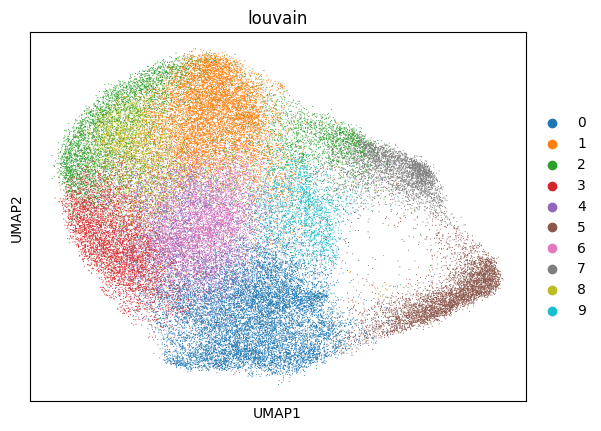

In [86]:
sc.pl.umap(ad_xen_sp, color='louvain')

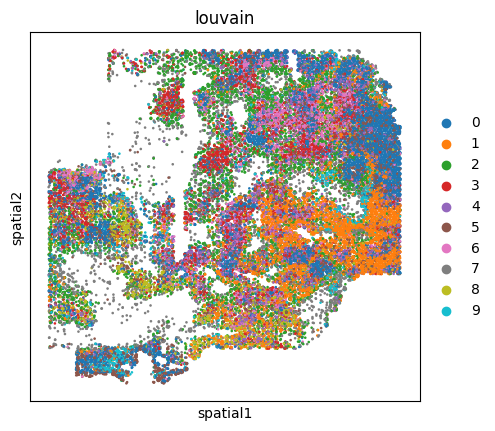

In [87]:
sc.pl.spatial(ad_xen_sp, color='louvain', alpha_img=0, spot_size=200)

In [88]:
marker_genes = {
    "Epithelial": ["KRT7", "KRT8", "KRT14", "KRT23", "ERBB2", "CDH1", "EPCAM", "EGFR", "KLF5", "DSP", "FOXA1"],
    "Myoepithelial": ["ACTA2"],
    "Macrophage": ["LYZ", "CD68", "FCER1G", "ITGAX", "CD163", "MRC1", "ITGAM", "FGL2", "ZEB2"],
    "Stroma": ["POSTN", "PDGFRB", "FBLN1", "TCF4", "LRRC15"],
    "B Cell": ["MZB1", "CD79A", "CD19", "CD79B", "MS4A1", "BANK1"],
    "Endothelial": ["VWF", "KDR", "CAV1", "ESM1", "PECAM1", "EGFL7"],
    "T Cell": ["PTPRC", "IL2RA", "CD3E", "FOXP3", "SLAMF7", "SLAMF1", "RORC", "CD4", "CD8A", "CTLA4", "IL7R", "CCL5", "IL2RG"],
    "Mast Cell": ["CD69"],
    "DCIS": ["CEACAM6"],
    "Invasive Tumor":["FASN"],
}

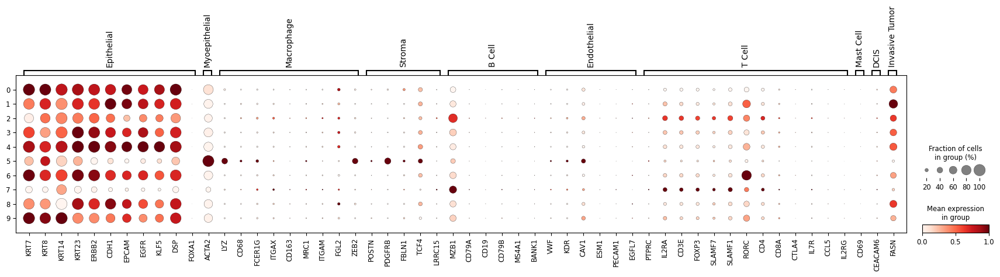

In [89]:
sc.pl.dotplot(ad_xen_sp, marker_genes, 
              # groupby="leiden", 
              groupby="louvain", 
              standard_scale="var"
             )

In [90]:
# ad_xen_sp.obs["cell_type_leiden10"] = ad_xen_sp.obs["leiden"].map(
#     {
#         "1": "Immune",
#         "6": "Stroma"
#     }
# )

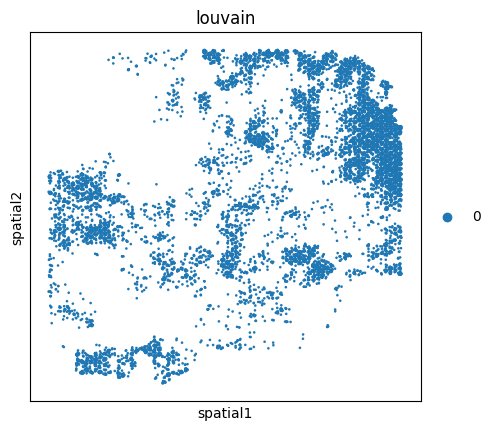

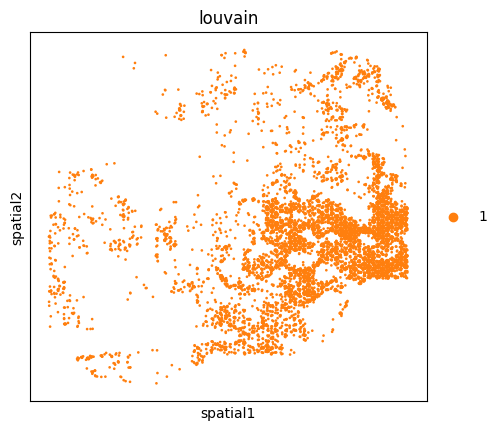

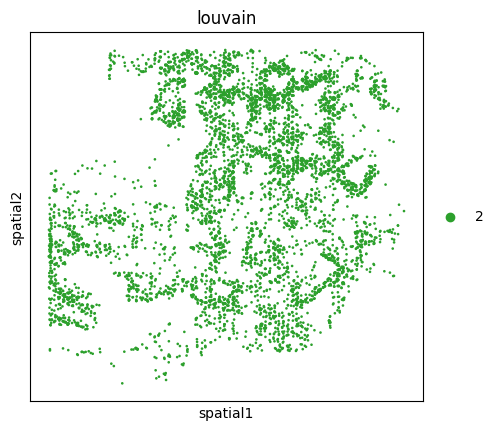

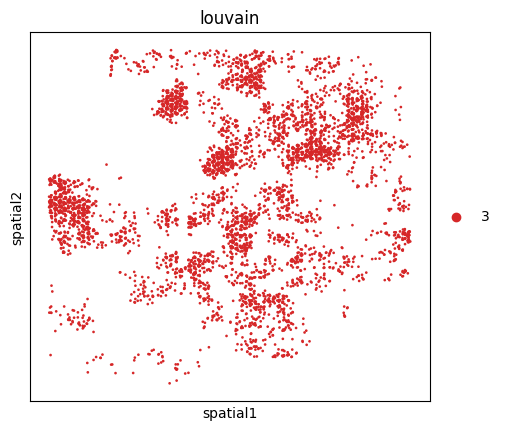

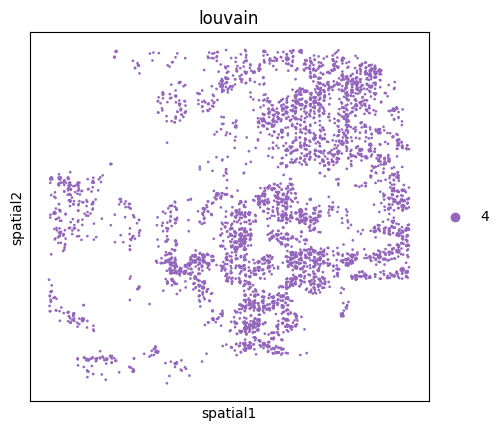

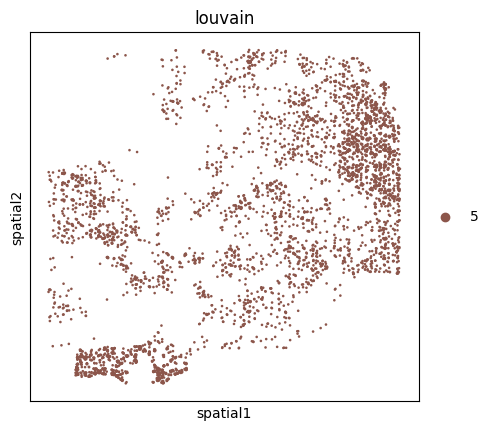

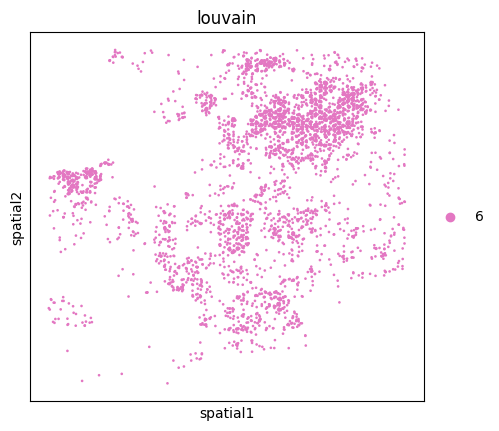

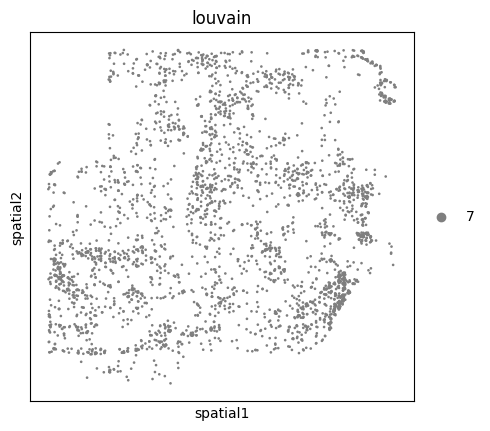

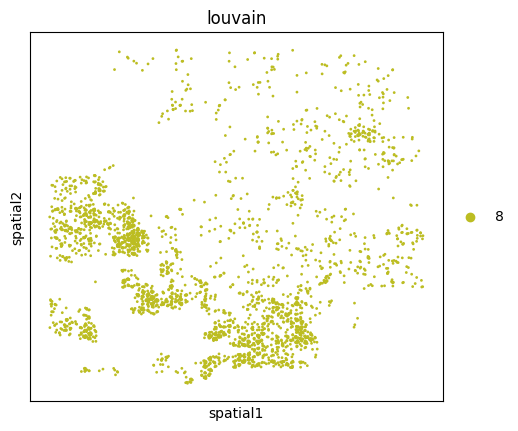

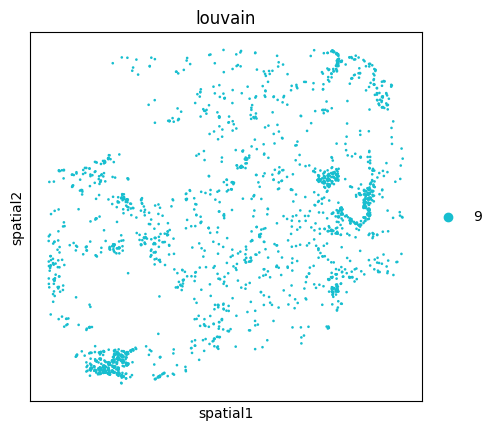

In [91]:
for i in range(10):
    sc.pl.spatial(ad_xen_sp[ad_xen_sp.obs['louvain']==str(i)], color='louvain', alpha_img=0, spot_size=200)

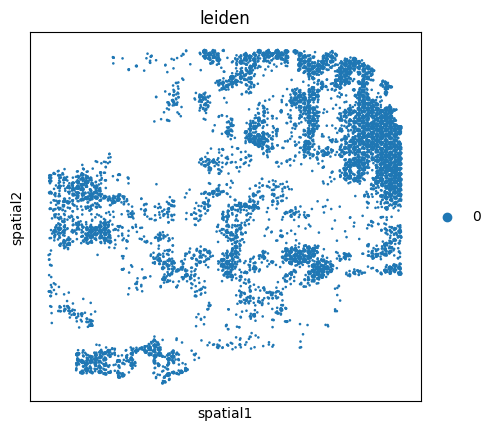

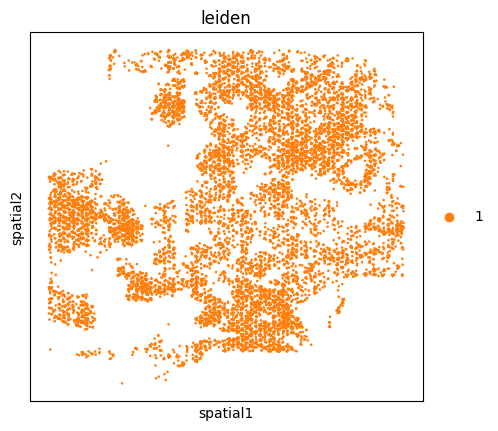

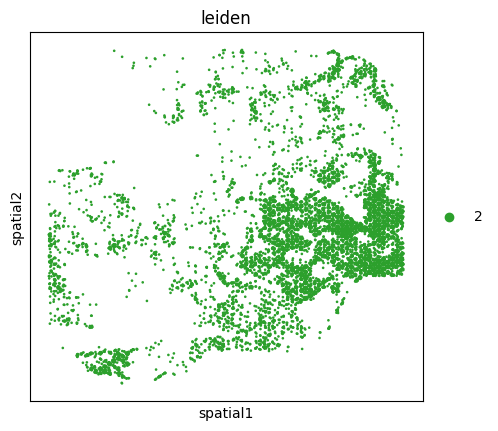

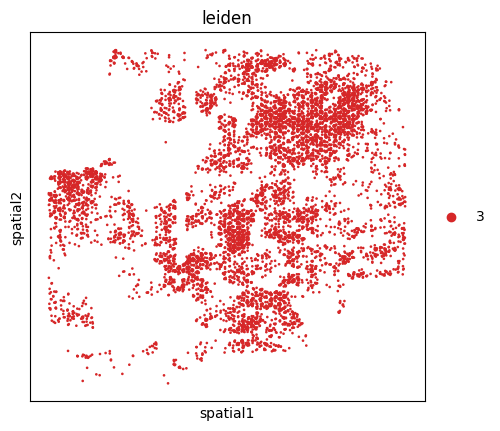

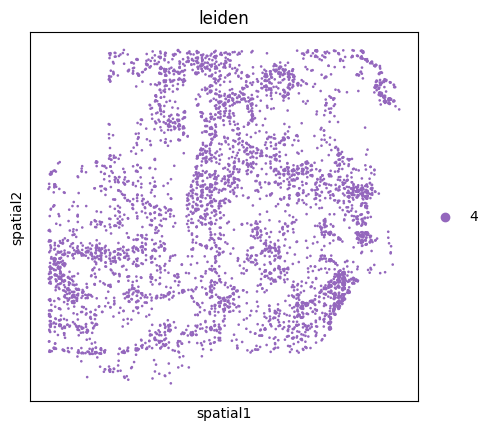

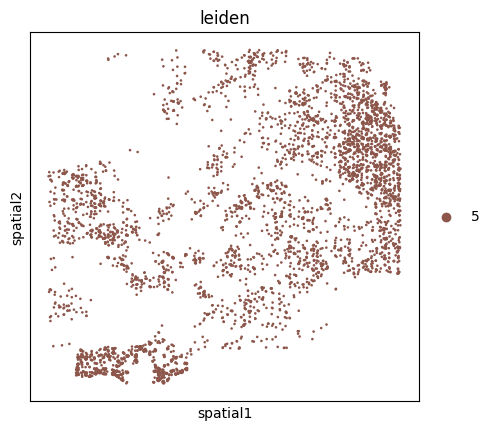

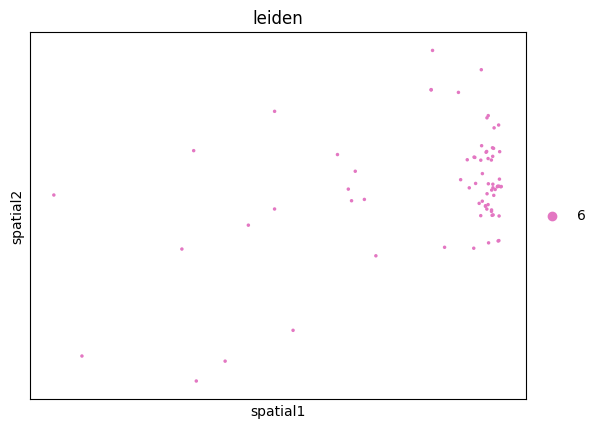

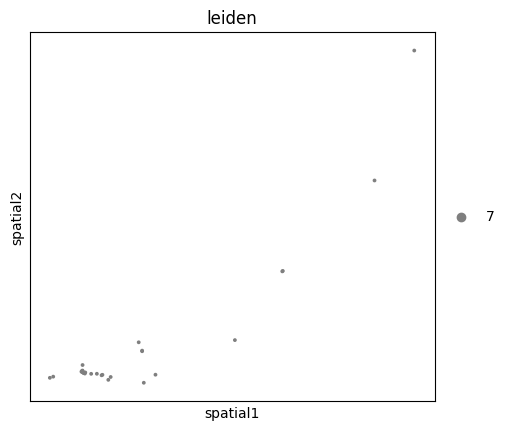

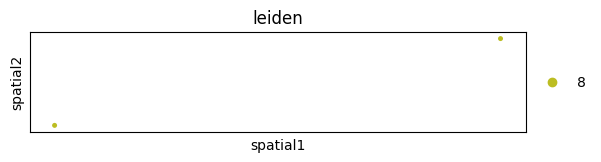

In [92]:
for i in range(9):
    sc.pl.spatial(ad_xen_sp[ad_xen_sp.obs['leiden']==str(i)], color='leiden', alpha_img=0, spot_size=200)

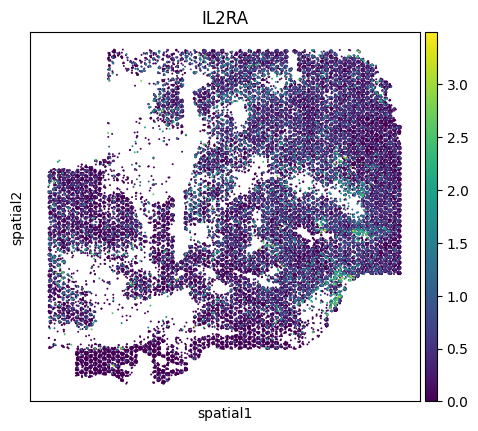

In [93]:
sc.pl.spatial(ad_xen_sp, color='IL2RA',alpha_img=0,spot_size=150)

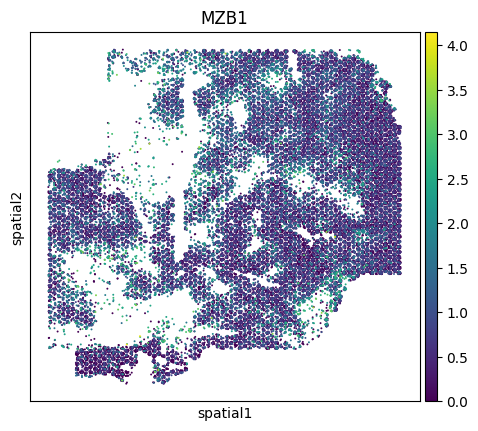

In [94]:
sc.pl.spatial(ad_xen_sp, color='MZB1',alpha_img=0,spot_size=150)

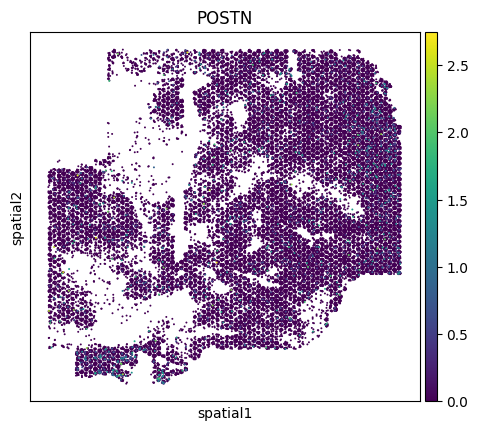

In [95]:
sc.pl.spatial(ad_xen_sp, color='POSTN',alpha_img=0,spot_size=150)

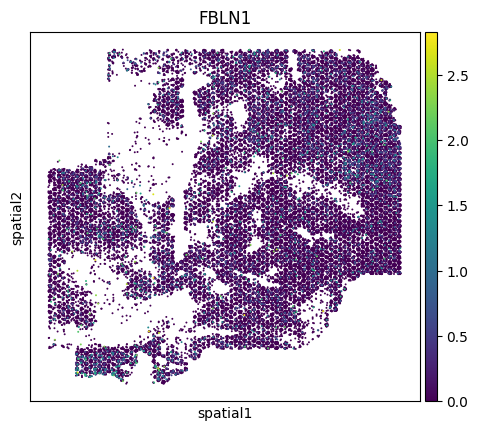

In [96]:
sc.pl.spatial(ad_xen_sp, color='FBLN1',alpha_img=0,spot_size=150)

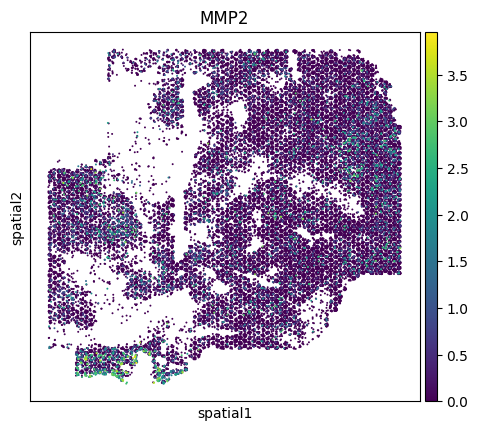

In [97]:
sc.pl.spatial(ad_xen_sp, color='MMP2',alpha_img=0,spot_size=150)

In [98]:
sc.tl.rank_genes_groups(ad_xen_sp, 
                        groupby='louvain',
                        # method='wilcoxon'
                       )

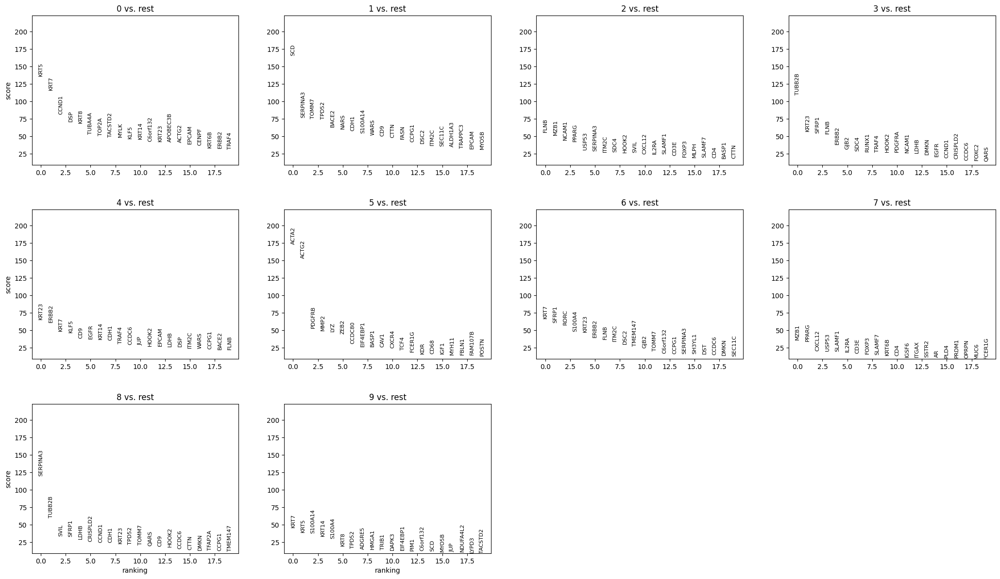

In [99]:
sc.pl.rank_genes_groups(ad_xen_sp)

In [100]:
sc.tl.dendrogram(ad_xen_sp, 
                 groupby="louvain"
                )

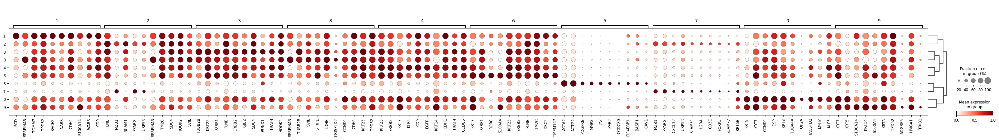

In [101]:
sc.pl.rank_genes_groups_dotplot(
    ad_xen_sp, 
    groupby="louvain", 
    standard_scale="var", 
    n_genes=10
)

In [102]:
ad_xen_sp.obs["cell_type_lv"] = ad_xen_sp.obs["louvain"].map(
    {
        "0": "Basal-like cancer",
        "1": "Epithelial1",
        "2": "Epithelial1",
        "3": "Epithelial2",        
        "4": "Epithelial3",
        "5": "Stroma",  
        "6": "Epithelial3",  
        "7": "Immune",
        "8": "Epithelial2",
        "9": "Basal-like cancer",
    }
)

In [103]:
ad_xen_sp.obs["cell_type"] = ad_xen_sp.obs["cell_type_lv"].map(
    {
        "Basal-like cancer": "Epithelial",
        "Epithelial1": "Epithelial",
        "Epithelial2": "Epithelial",
        "Epithelial3": "Epithelial",        
        "Stroma": "Stroma",
        "Immune": "Immune",  
    }
)

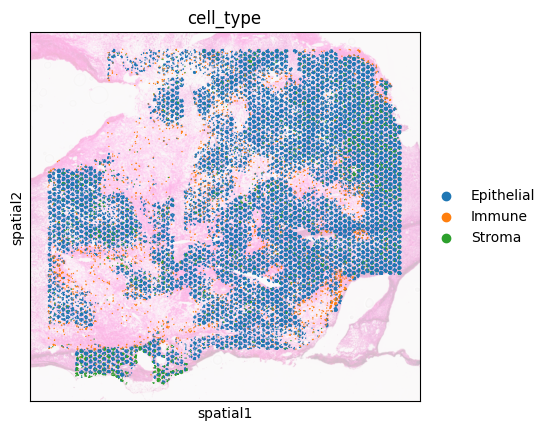

In [104]:
sc.pl.spatial(ad_xen_sp, color='cell_type', alpha_img=0.3, spot_size=100)

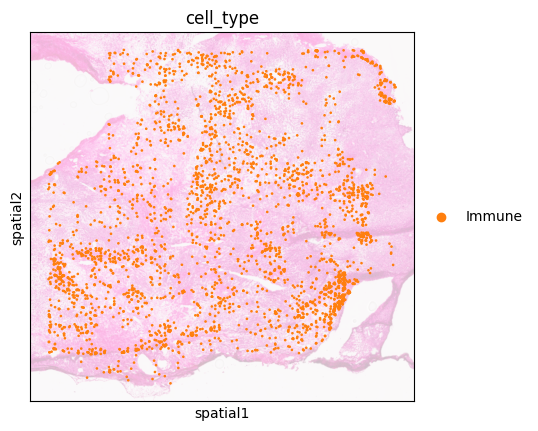

In [105]:
sc.pl.spatial(ad_xen_sp[ad_xen_sp.obs['cell_type']=='Immune'], color='cell_type', alpha_img=0.3, spot_size=200)

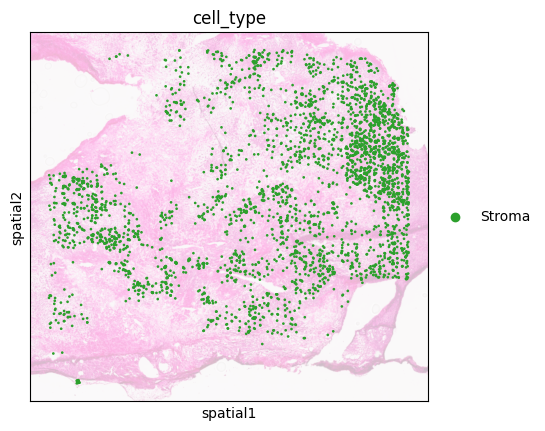

In [447]:
sc.pl.spatial(ad_xen_sp[ad_xen_sp.obs['cell_type']=='Stroma'], color='cell_type', alpha_img=0.3, spot_size=200)

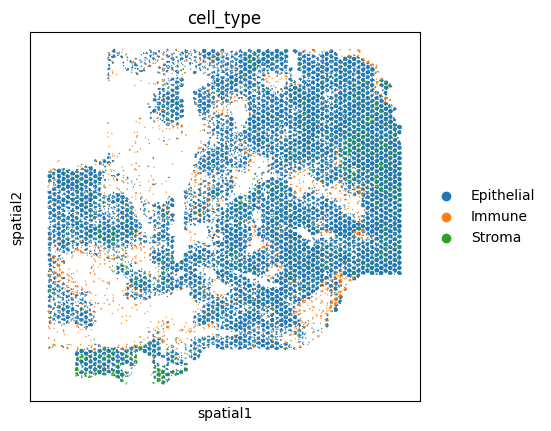

In [259]:
sc.pl.spatial(ad_xen_sp, color='cell_type', alpha_img=0, spot_size=100)

In [52]:
ad_xen_sp.obs

,in_tissue,spot,n_counts,leiden,louvain,cell_type_lv,cell_type
aaaanbak-1,1,TNBC_processed_adata_ACAGAATACATACTAA-1,127.0,2,1,Epithelial1,Epithelial
aaaanegh-1,1,TNBC_processed_adata_ACAGAATACATACTAA-1,214.0,2,1,Epithelial1,Epithelial
aaaanhnf-1,1,TNBC_processed_adata_ACAGAATACATACTAA-1,123.0,2,1,Epithelial1,Epithelial
aaaapjii-1,1,TNBC_processed_adata_ACAGAATACATACTAA-1,416.0,2,1,Epithelial1,Epithelial
aaabaaca-1,1,TNBC_processed_adata_ACAGAATACATACTAA-1,521.0,2,0,Basal-like cancer,Epithelial
...,...,...,...,...,...,...,...
oilefejp-1,1,TNBC_processed_adata_AACGAGCTAATAACTA-1,78.0,5,5,Stroma,Stroma
oilejpac-1,1,TNBC_processed_adata_AACGAGCTAATAACTA-1,281.0,3,4,Epithelial3,Epithelial
oilfamde-1,1,TNBC_processed_adata_AACGAGCTAATAACTA-1,144.0,3,6,Epithelial3,Epithelial
oilfhkkg-1,1,TNBC_processed_adata_AACGAGCTAATAACTA-1,187.0,3,4,Epithelial3,Epithelial


In [106]:
ad_xen_sp.write_h5ad('/condo/wanglab/shared/wxc/clip/data/human/HM_data/TNBC_Xenium_spot_anno.h5ad')

# Visium Data

## Preprocess Data

In [283]:
ad = sc.read_h5ad(data_path+sample_name+'_cell_num.h5ad')

In [284]:
ad

AnnData object with n_obs × n_vars = 4168 × 18085
    obs: 'in_tissue', 'array_row', 'array_col', 'pixel_y', 'pixel_x', 'cell_num'
    var: 'gene_ids', 'feature_types', 'genome'
    uns: 'spatial'
    obsm: 'spatial'

In [285]:
ad.X.todense()

matrix([[0., 0., 0., ..., 0., 0., 1.],
        [1., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        ...,
        [0., 0., 0., ..., 0., 3., 0.],
        [3., 0., 1., ..., 0., 1., 2.],
        [0., 1., 1., ..., 0., 1., 0.]], dtype=float32)

In [286]:
# ad.var_names_make_unique()
# ad.obs.index = sample_name+'_'+ad.obs.index
# ad.obs[['pixel_y','pixel_x']] = ad.obsm['spatial']
# ad.write_h5ad(data_path+sample_name+'.h5ad')

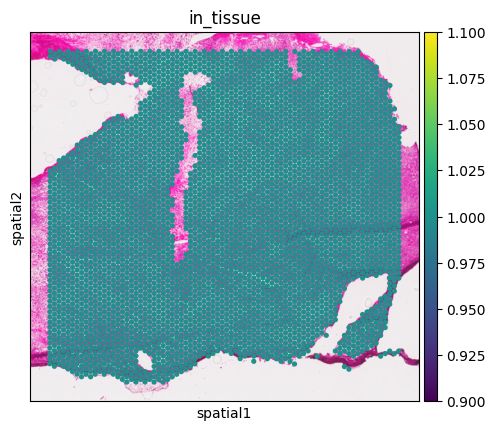

In [287]:
sc.pl.spatial(ad, alpha_img=1,color='in_tissue',spot_size=400)

In [288]:
ad_xen_sp = sc.read_h5ad('/condo/wanglab/shared/wxc/clip/data/human/HM_data/TNBC_Xenium_spot_anno.h5ad')

In [289]:
ad = ad[ad.obs.index.isin(ad_xen_sp.obs['spot'])]

In [290]:
ad

View of AnnData object with n_obs × n_vars = 3402 × 18085
    obs: 'in_tissue', 'array_row', 'array_col', 'pixel_y', 'pixel_x', 'cell_num'
    var: 'gene_ids', 'feature_types', 'genome'
    uns: 'spatial'
    obsm: 'spatial'

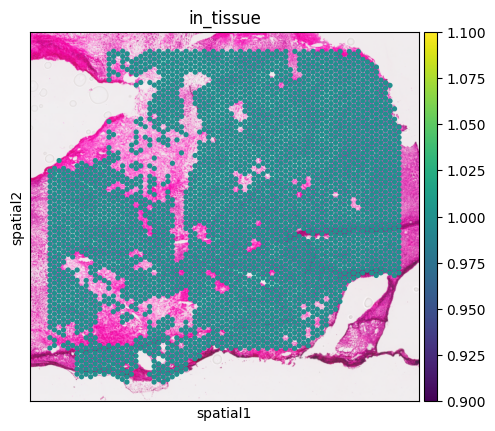

In [291]:
sc.pl.spatial(ad, alpha_img=1,color='in_tissue',spot_size=400)

In [292]:
sc.pp.filter_cells(ad, min_genes=100)
sc.pp.filter_genes(ad, min_cells=3)

In [293]:
ad

AnnData object with n_obs × n_vars = 3104 × 16300
    obs: 'in_tissue', 'array_row', 'array_col', 'pixel_y', 'pixel_x', 'cell_num', 'n_genes'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells'
    uns: 'spatial'
    obsm: 'spatial'

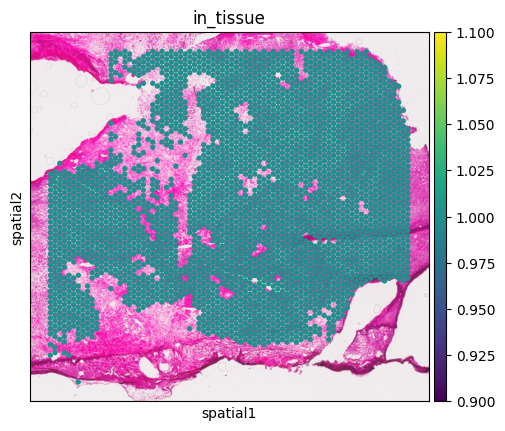

In [294]:
sc.pl.spatial(ad, alpha_img=1,color='in_tissue',spot_size=400)

In [295]:
ad = ad[ad.obs['cell_num']>0]

In [296]:
ad

View of AnnData object with n_obs × n_vars = 3104 × 16300
    obs: 'in_tissue', 'array_row', 'array_col', 'pixel_y', 'pixel_x', 'cell_num', 'n_genes'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells'
    uns: 'spatial'
    obsm: 'spatial'

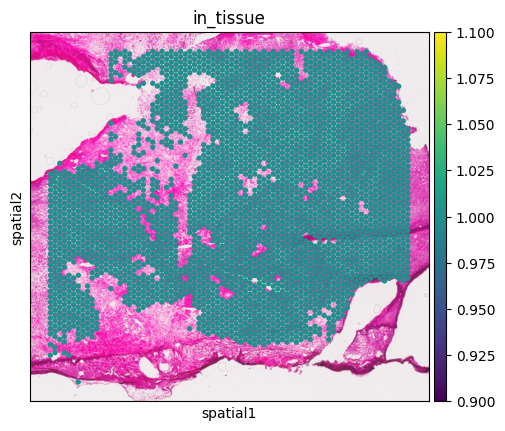

In [297]:
sc.pl.spatial(ad, alpha_img=1,color='in_tissue',spot_size=400)

In [298]:
ad.layers["counts"] = ad.X.copy()

In [299]:
sc.pp.normalize_total(ad)
sc.pp.log1p(ad)

In [300]:
ad.X.todense()

matrix([[0.        , 0.        , 0.        , ..., 0.        , 0.        ,
         3.167056  ],
        [1.818519  , 0.        , 0.        , ..., 0.        , 0.        ,
         0.        ],
        [0.8961585 , 0.        , 0.        , ..., 0.        , 0.8961585 ,
         0.8961585 ],
        ...,
        [0.        , 0.        , 0.        , ..., 0.        , 2.120819  ,
         0.        ],
        [0.75166786, 0.        , 0.31737044, ..., 0.        , 0.31737044,
         0.55791295],
        [0.        , 1.0857089 , 1.0857089 , ..., 0.        , 1.0857089 ,
         0.        ]], dtype=float32)

In [301]:
ad.write_h5ad(data_path+sample_name+'_filter100g.h5ad')

## QC

In [6]:
ad = sc.read_h5ad(data_path+sample_name+'_filter100g.h5ad')

In [7]:
ad

AnnData object with n_obs × n_vars = 3104 × 16300
    obs: 'in_tissue', 'array_row', 'array_col', 'pixel_y', 'pixel_x', 'cell_num', 'n_genes'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells'
    uns: 'log1p', 'spatial'
    obsm: 'spatial'
    layers: 'counts'

In [304]:
sc.pp.pca(ad)
sc.pp.neighbors(ad)

In [332]:
sc.tl.umap(ad)

In [346]:
sc.tl.leiden(ad, resolution=0.247)

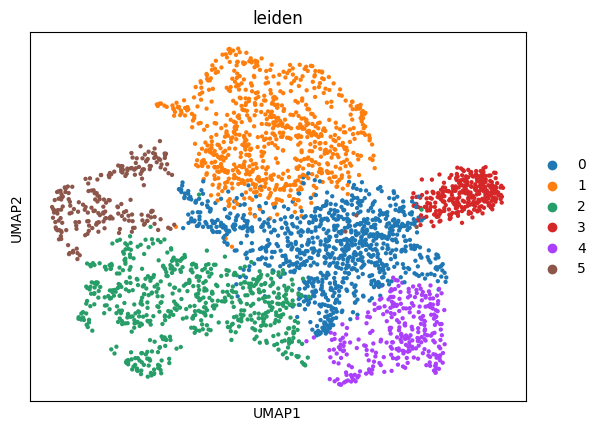

In [347]:
sc.pl.umap(ad, color='leiden')

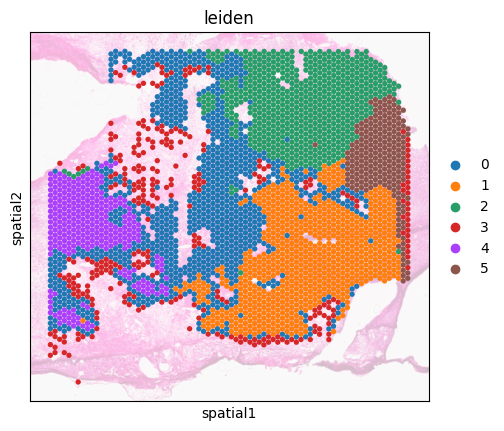

In [348]:
sc.pl.spatial(ad, color='leiden',alpha_img=0.3,spot_size=400)

In [328]:
sc.tl.louvain(ad, resolution=0.3)

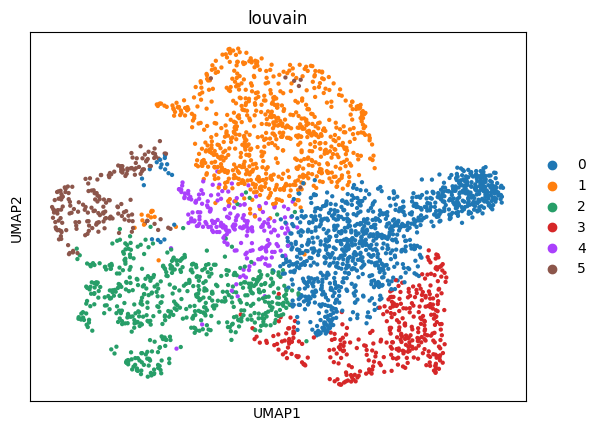

In [329]:
sc.pl.umap(ad, color='louvain')

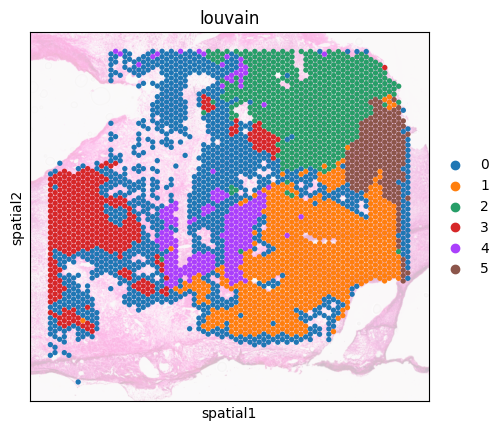

In [330]:
sc.pl.spatial(ad, color='louvain',alpha_img=0.3,spot_size=400)

In [356]:
sc.tl.rank_genes_groups(ad, 
                        groupby='louvain',
                        # method='wilcoxon'
                       )

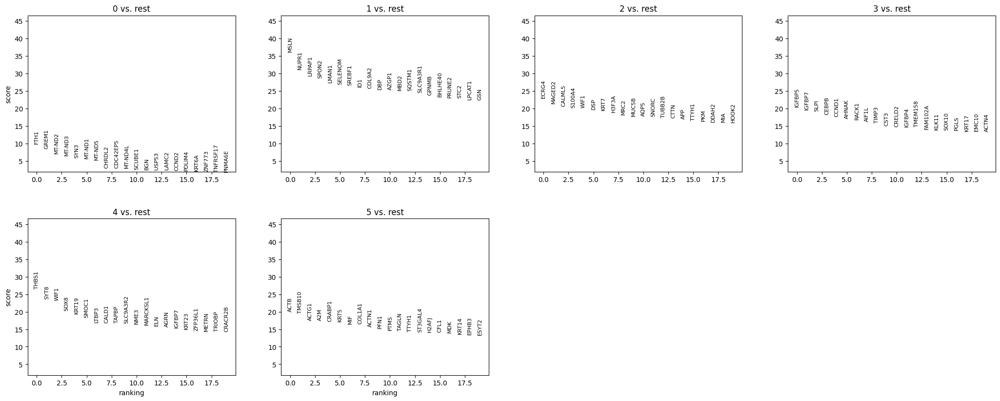

In [357]:
sc.pl.rank_genes_groups(ad)

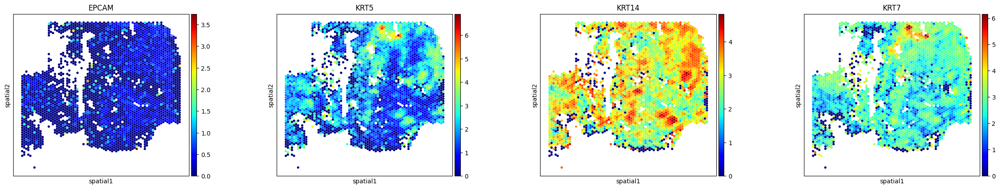

In [365]:
sc.pl.spatial(ad, alpha_img=0,color=['EPCAM', 'KRT5', 'KRT14', 'KRT7'],spot_size=400, cmap='jet')

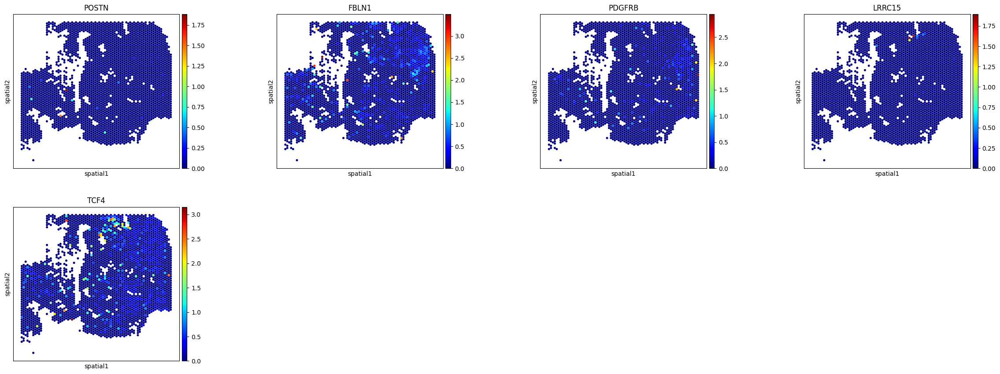

In [375]:
sc.pl.spatial(ad, color=['POSTN', 'FBLN1','PDGFRB', 'LRRC15', 'TCF4'], alpha_img=0, cmap='jet', spot_size=400)

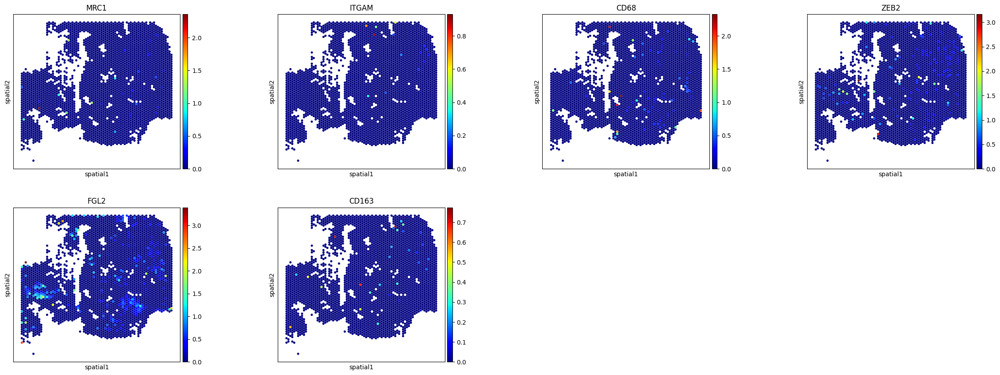

In [377]:
sc.pl.spatial(ad, color=['MRC1', 'ITGAM', 'CD68', 'ZEB2', 'FGL2', 'CD163'], alpha_img=0, cmap='jet', spot_size=400)

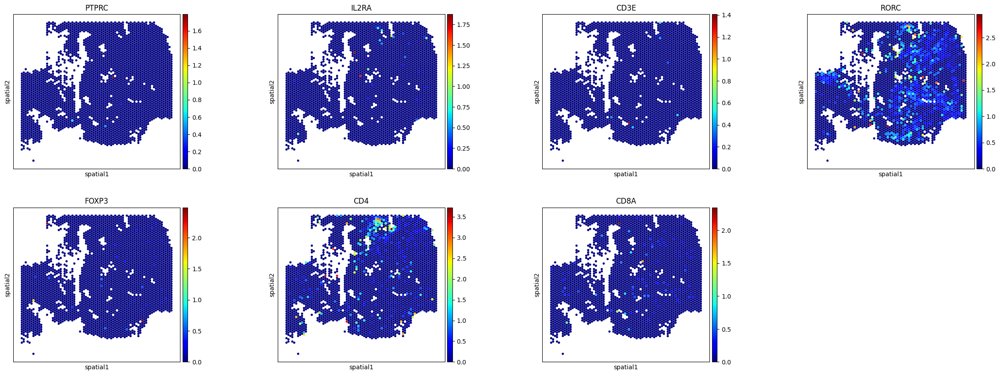

In [387]:
sc.pl.spatial(ad, color=['PTPRC', 'IL2RA', 'CD3E', 'RORC', 'FOXP3','CD4','CD8A'], alpha_img=0, cmap='jet', spot_size=400)

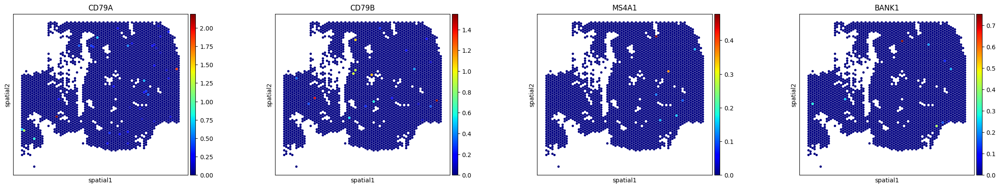

In [385]:
sc.pl.spatial(ad, color=['CD79A', 'CD79B', 'MS4A1','BANK1'], alpha_img=0, cmap='jet', spot_size=400)

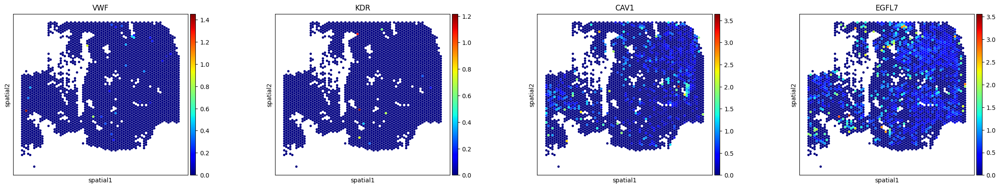

In [386]:
sc.pl.spatial(ad, color=['VWF', 'KDR', 'CAV1', 'EGFL7'], alpha_img=0, cmap='jet', spot_size=400)